In [1]:
import tensorflow as tf
tf.__version__
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 4511138753349134522,
 name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 598679401317335215
 physical_device_desc: "device: XLA_CPU device",
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 6920575392
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 11030955031289431956
 physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 2080 SUPER, pci bus id: 0000:01:00.0, compute capability: 7.5",
 name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 2587812692430097242
 physical_device_desc: "device: XLA_GPU device"]

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [3]:
tf.debugging.set_log_device_placement(True)

a = tf.constant([[1.0, 2.0, 3.0], [4.0, 5.0, 6.0]])
b = tf.constant([[1.0, 2.0], [3.0, 4.0], [5.0, 6.0]])
c = tf.matmul(a, b)
print(c)

Executing op MatMul in device /job:localhost/replica:0/task:0/device:GPU:0
tf.Tensor(
[[22. 28.]
 [49. 64.]], shape=(2, 2), dtype=float32)


In [4]:
import keras
from keras.models import Sequential, Model
from keras import layers, applications, optimizers
from keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, Activation, GlobalMaxPooling2D, BatchNormalization, ZeroPadding2D, Input, Add
from keras.preprocessing.image import ImageDataGenerator, load_img

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import random

In [5]:
epoch = 100
batch_size = 5
image_size = 224

In [6]:
#load train data(25000 imgs each)

filenames = os.listdir('./input/train/train')
data = []
categories = []

for filename in filenames:
    category = filename.split('.')[0]
    if category == 'dog':
        categories.append(1)
    else:
        categories.append(0)
    
    image = load_img(os.path.join('./input/train/train', filename), color_mode='rgb', target_size= (image_size,image_size))
    image = np.array(image)
    data.append(image)

data = np.array(data)
categories = np.array(categories)

print(data)
print(categories)

[[[[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 203 119]
   [241 202 123]
   [239 200 121]]

  [[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 205 120]
   [242 203 124]
   [240 201 122]]

  [[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 204 122]
   [243 204 125]
   [241 202 123]]

  ...

  [[154 123  56]
   [155 124  57]
   [156 125  58]
   ...
   [  3   3   1]
   [  3   3   1]
   [  3   3   1]]

  [[153 122  55]
   [153 122  55]
   [154 123  56]
   ...
   [  2   2   0]
   [  2   2   0]
   [  2   2   0]]

  [[151 120  53]
   [152 121  54]
   [153 122  55]
   ...
   [  1   1   0]
   [  1   1   0]
   [  1   1   0]]]


 [[[ 39  44  40]
   [ 40  44  43]
   [ 41  45  46]
   ...
   [210 209 181]
   [207 204 171]
   [201 199 161]]

  [[ 40  45  41]
   [ 40  44  43]
   [ 41  45  46]
   ...
   [207 203 176]
   [203 200 169]
   [197 195 157]]

  [[ 39  44  40]
   [ 38  42  41]
   [ 37  41  42]
   ...
   [195 191 166]
   [198 193 164]
   [205 200

In [7]:
# shuffle dataset

idx = np.random.permutation(len(data))
data, categories = data[idx], categories[idx]

In [8]:
# split train 6(15,000) / val 2(5,000) / test 2(5,000)

x_train = data[:15000]
y_train = categories[:15000]
x_temp, y_temp = data[-10000:], categories[-10000:]

from sklearn.model_selection import train_test_split

x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5)

In [9]:
# data augmentation in train set (train 15,000 to 75,000)

x_train_temp = x_train
y_train_temp = y_train

x_train_aug = []
y_train_aug = []

for img, label in zip(x_train_temp, y_train_temp):
    curImg = img
    
    flipped1 = tf.image.flip_left_right(curImg)
    flipped2 = tf.image.flip_up_down(curImg)
    
    x_train_aug.append(flipped1)
    x_train_aug.append(flipped2)
    
    for i in range(3):
        cropped = curImg[random.randrange(0,100):random.randrange(180,225), random.randrange(0,100):random.randrange(180,225)]
        cropped = cv2.resize(cropped, (image_size, image_size))
        x_train_aug.append(cropped)
    
    for i in range(0, 5):
        y_train_aug.append(label)
        
x_train_aug = np.array(x_train_aug)
y_train_aug = np.array(y_train_aug)

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

In [10]:
x_train = np.concatenate((x_train, x_train_aug))
y_train = np.concatenate((y_train, y_train_aug))

In [11]:
def build_resnet_block(input_layer, num_cnn=3, channel=64, block_num=1):

    x = input_layer
    
    for cnn_num in range(num_cnn):
        shortcut = x
        x = keras.layers.Conv2D(filters=channel, kernel_size=(3,3), activation='relu', kernel_initializer='he_normal',
            padding='same', name=f'block{block_num}_conv{cnn_num}')(x)
        x = keras.layers.BatchNormalization()(x)
        x = keras.layers.Conv2D( filters=channel, kernel_size=(3,3), activation='relu', kernel_initializer='he_normal',
            padding='same', name=f'block{block_num}_1_conv{cnn_num}')(x)

        shortcut_channel = shortcut.shape.as_list()[-1]
        if shortcut_channel != channel:
            shortcut = Conv2D(channel, kernel_size=(1,1), strides=(1,1), padding='same')(shortcut)  
        # skip connection
        x = keras.layers.Add()([x, shortcut])

    return x

In [12]:
def build_resnet(input_shape=(image_size, image_size, 3),
              num_cnn_list=[3, 4, 6, 3], channel_list=[64, 128, 256, 512], num_classes=2):
        
    input_layer = keras.layers.Input(shape=input_shape)
    
    output = input_layer
    
    output = keras.layers.Conv2D(filters=64, kernel_size=(7,7), strides=2, padding = 'same')(output)
    output = keras.layers.BatchNormalization()(output)
    output = keras.layers.MaxPooling2D(pool_size=(3, 3), strides=2)(output)
    
    for i, (num_cnn, channel) in enumerate(zip(num_cnn_list, channel_list)):
        output = build_resnet_block(output, num_cnn=num_cnn, channel=channel, block_num=i)
        
    output = keras.layers.AveragePooling2D(padding = 'same')(output)
    output = keras.layers.Flatten(name='flatten')(output)
    output = keras.layers.Dense(1000, activation='relu', name='fc1')(output)    
    output = keras.layers.Dense(num_classes, activation='softmax', name='softmax')(output)
    
    model = keras.Model(
        inputs=input_layer,
        outputs=output
    )
    
    return model

In [13]:
# readymade ResNet50

from keras.applications.resnet50 import ResNet50

model = ResNet50()

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

In [14]:
# model = build_resnet()

In [15]:
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    metrics=['accuracy']
)

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

In [16]:
model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
___________________________________________________________________________________________

conv4_block3_2_conv (Conv2D)    (None, 14, 14, 256)  590080      conv4_block3_1_relu[0][0]        
__________________________________________________________________________________________________
conv4_block3_2_bn (BatchNormali (None, 14, 14, 256)  1024        conv4_block3_2_conv[0][0]        
__________________________________________________________________________________________________
conv4_block3_2_relu (Activation (None, 14, 14, 256)  0           conv4_block3_2_bn[0][0]          
__________________________________________________________________________________________________
conv4_block3_3_conv (Conv2D)    (None, 14, 14, 1024) 263168      conv4_block3_2_relu[0][0]        
__________________________________________________________________________________________________
conv4_block3_3_bn (BatchNormali (None, 14, 14, 1024) 4096        conv4_block3_3_conv[0][0]        
__________________________________________________________________________________________________
conv4_bloc

In [17]:
# %load_ext tensorboard
%reload_ext tensorboard

import datetime

In [18]:
log_dir = "logs/resnet_da_new/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [19]:
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

early_stopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10)
model_checkpoint = ModelCheckpoint('resnet.h5', monitor='val_loss', mode='min', verbose=1, save_best_only=True)

In [20]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=1)

In [21]:
epoch = 30

history = model.fit(
    x_train, y_train,
    epochs=epoch,
    validation_data=(x_val, y_val),
    verbose=1,
    callbacks=[tensorboard_callback, reduce_lr]
)

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op SummaryWriter 

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device 

Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:loc

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device 

Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:loc

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
   1/2813 [..............................] - ETA: 0s - loss: 10.4164 - accuracy: 0.0000e+00Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
Executing op FlushSummaryWriter in device /job:localhost/replica:0/tas

  80/2813 [..............................] - ETA: 7:30 - loss: 2.8938 - accuracy: 0.5109Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 123/2813 [>.............................] - ETA: 7:24 - loss: 2.2294 - accuracy: 0.5183Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 166/2813 [>.............................] - ETA: 7:17 - loss: 1.8512 - accuracy: 0.5230Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 209/2813 [=>............................] - ETA: 7:10 - loss: 1.6200 - accuracy: 0.5262Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 252/2813 [=>............................] - ETA: 7:03 - loss: 1.4662 - accuracy: 0.5319Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 295/2813 [==>...........................] - ETA: 6:57 - loss: 1.3600 - accuracy: 0.5325Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 338/2813 [==>...........................] - ETA: 6:50 - loss: 1.2771 - accuracy: 0.5332Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 381/2813 [===>..........................] - ETA: 6:43 - loss: 1.2170 - accuracy: 0.5358Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 424/2813 [===>..........................] - ETA: 6:36 - loss: 1.1644 - accuracy: 0.5363Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 467/2813 [===>..........................] - ETA: 6:29 - loss: 1.1232 - accuracy: 0.5383Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 510/2813 [====>.........................] - ETA: 6:22 - loss: 1.0895 - accuracy: 0.5377Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 553/2813 [====>.........................] - ETA: 6:15 - loss: 1.0596 - accuracy: 0.5383Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 596/2813 [=====>........................] - ETA: 6:07 - loss: 1.0350 - accuracy: 0.5383Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 639/2813 [=====>........................] - ETA: 6:00 - loss: 1.0130 - accuracy: 0.5393Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 682/2813 [======>.......................] - ETA: 5:53 - loss: 0.9935 - accuracy: 0.5403Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 725/2813 [======>.......................] - ETA: 5:46 - loss: 0.9777 - accuracy: 0.5404Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 768/2813 [=======>......................] - ETA: 5:39 - loss: 0.9625 - accuracy: 0.5413Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 811/2813 [=======>......................] - ETA: 5:32 - loss: 0.9482 - accuracy: 0.5423Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 854/2813 [========>.....................] - ETA: 5:24 - loss: 0.9365 - accuracy: 0.5430Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 897/2813 [========>.....................] - ETA: 5:17 - loss: 0.9258 - accuracy: 0.5437Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 940/2813 [=========>....................] - ETA: 5:10 - loss: 0.9150 - accuracy: 0.5446Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 983/2813 [=========>....................] - ETA: 5:03 - loss: 0.9054 - accuracy: 0.5462Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1026/2813 [=========>....................] - ETA: 4:56 - loss: 0.8971 - accuracy: 0.5459Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1069/2813 [==========>...................] - ETA: 4:49 - loss: 0.8890 - accuracy: 0.5459Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1112/2813 [==========>...................] - ETA: 4:42 - loss: 0.8819 - accuracy: 0.5453Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1155/2813 [===========>..................] - ETA: 4:34 - loss: 0.8742 - accuracy: 0.5470Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1198/2813 [===========>..................] - ETA: 4:27 - loss: 0.8673 - accuracy: 0.5482Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1241/2813 [============>.................] - ETA: 4:20 - loss: 0.8613 - accuracy: 0.5481Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1284/2813 [============>.................] - ETA: 4:13 - loss: 0.8553 - accuracy: 0.5488Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1327/2813 [=============>................] - ETA: 4:06 - loss: 0.8502 - accuracy: 0.5492Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1370/2813 [=============>................] - ETA: 3:59 - loss: 0.8450 - accuracy: 0.5500Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1413/2813 [==============>...............] - ETA: 3:52 - loss: 0.8397 - accuracy: 0.5512Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1456/2813 [==============>...............] - ETA: 3:45 - loss: 0.8345 - accuracy: 0.5528Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1499/2813 [==============>...............] - ETA: 3:37 - loss: 0.8299 - accuracy: 0.5536Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1542/2813 [===============>..............] - ETA: 3:30 - loss: 0.8257 - accuracy: 0.5540Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1585/2813 [===============>..............] - ETA: 3:23 - loss: 0.8216 - accuracy: 0.5550Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1628/2813 [================>.............] - ETA: 3:16 - loss: 0.8184 - accuracy: 0.5552Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1671/2813 [================>.............] - ETA: 3:09 - loss: 0.8142 - accuracy: 0.5566Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1714/2813 [=================>............] - ETA: 3:02 - loss: 0.8103 - accuracy: 0.5576Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1757/2813 [=================>............] - ETA: 2:55 - loss: 0.8067 - accuracy: 0.5585Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1800/2813 [==================>...........] - ETA: 2:47 - loss: 0.8033 - accuracy: 0.5591Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1843/2813 [==================>...........] - ETA: 2:40 - loss: 0.7997 - accuracy: 0.5604Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1886/2813 [===================>..........] - ETA: 2:33 - loss: 0.7962 - accuracy: 0.5619Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1929/2813 [===================>..........] - ETA: 2:26 - loss: 0.7927 - accuracy: 0.5632Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1972/2813 [====================>.........] - ETA: 2:19 - loss: 0.7898 - accuracy: 0.5640Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2015/2813 [====================>.........] - ETA: 2:12 - loss: 0.7870 - accuracy: 0.5651Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2058/2813 [====================>.........] - ETA: 2:05 - loss: 0.7840 - accuracy: 0.5662Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2101/2813 [=====================>........] - ETA: 1:58 - loss: 0.7819 - accuracy: 0.5664Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2144/2813 [=====================>........] - ETA: 1:50 - loss: 0.7791 - accuracy: 0.5678Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2187/2813 [======================>.......] - ETA: 1:43 - loss: 0.7759 - accuracy: 0.5692Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2230/2813 [======================>.......] - ETA: 1:36 - loss: 0.7734 - accuracy: 0.5705Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2273/2813 [=======================>......] - ETA: 1:29 - loss: 0.7706 - accuracy: 0.5721Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2316/2813 [=======================>......] - ETA: 1:22 - loss: 0.7680 - accuracy: 0.5736Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2359/2813 [========================>.....] - ETA: 1:15 - loss: 0.7656 - accuracy: 0.5748Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2402/2813 [========================>.....] - ETA: 1:08 - loss: 0.7631 - accuracy: 0.5762Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2445/2813 [=========================>....] - ETA: 1:01 - loss: 0.7607 - accuracy: 0.5774Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2488/2813 [=========================>....] - ETA: 53s - loss: 0.7581 - accuracy: 0.5791Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2531/2813 [=========================>....] - ETA: 46s - loss: 0.7558 - accuracy: 0.5801Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2574/2813 [==========================>...] - ETA: 39s - loss: 0.7538 - accuracy: 0.5812Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2617/2813 [==========================>...] - ETA: 32s - loss: 0.7517 - accuracy: 0.5821Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2660/2813 [===========================>..] - ETA: 25s - loss: 0.7496 - accuracy: 0.5836Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2703/2813 [===========================>..] - ETA: 18s - loss: 0.7485 - accuracy: 0.5839Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2746/2813 [============================>.] - ETA: 11s - loss: 0.7468 - accuracy: 0.5845Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2790/2813 [============================>.] - ETA: 3s - loss: 0.7450 - accuracy: 0.5855Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.7439 - accuracy: 0.5862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  54/2813 [..............................] - ETA: 7:29 - loss: 0.5995 - accuracy: 0.6725Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  97/2813 [>.............................] - ETA: 7:26 - loss: 0.6087 - accuracy: 0.6704Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 140/2813 [>.............................] - ETA: 7:20 - loss: 0.6051 - accuracy: 0.6757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 183/2813 [>.............................] - ETA: 7:13 - loss: 0.6100 - accuracy: 0.6713Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 226/2813 [=>............................] - ETA: 7:07 - loss: 0.6096 - accuracy: 0.6699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 269/2813 [=>............................] - ETA: 7:00 - loss: 0.6087 - accuracy: 0.6707Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 312/2813 [==>...........................] - ETA: 6:53 - loss: 0.6086 - accuracy: 0.6679Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 355/2813 [==>...........................] - ETA: 6:46 - loss: 0.6089 - accuracy: 0.6667Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 398/2813 [===>..........................] - ETA: 6:39 - loss: 0.6088 - accuracy: 0.6671Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 441/2813 [===>..........................] - ETA: 6:32 - loss: 0.6086 - accuracy: 0.6670Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 484/2813 [====>.........................] - ETA: 6:25 - loss: 0.6078 - accuracy: 0.6677Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 527/2813 [====>.........................] - ETA: 6:18 - loss: 0.6073 - accuracy: 0.6695Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 570/2813 [=====>........................] - ETA: 6:11 - loss: 0.6052 - accuracy: 0.6712Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 613/2813 [=====>........................] - ETA: 6:04 - loss: 0.6055 - accuracy: 0.6717Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 656/2813 [=====>........................] - ETA: 5:57 - loss: 0.6061 - accuracy: 0.6709Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 699/2813 [======>.......................] - ETA: 5:49 - loss: 0.6064 - accuracy: 0.6693Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 742/2813 [======>.......................] - ETA: 5:42 - loss: 0.6058 - accuracy: 0.6714Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 785/2813 [=======>......................] - ETA: 5:35 - loss: 0.6041 - accuracy: 0.6723Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 828/2813 [=======>......................] - ETA: 5:28 - loss: 0.6031 - accuracy: 0.6731Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 871/2813 [========>.....................] - ETA: 5:21 - loss: 0.6033 - accuracy: 0.6722Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 914/2813 [========>.....................] - ETA: 5:14 - loss: 0.6029 - accuracy: 0.6724Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 957/2813 [=========>....................] - ETA: 5:07 - loss: 0.6026 - accuracy: 0.6724Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1000/2813 [=========>....................] - ETA: 5:00 - loss: 0.6028 - accuracy: 0.6718Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1043/2813 [==========>...................] - ETA: 4:53 - loss: 0.6024 - accuracy: 0.6724Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1086/2813 [==========>...................] - ETA: 4:45 - loss: 0.6020 - accuracy: 0.6731Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1129/2813 [===========>..................] - ETA: 4:38 - loss: 0.6012 - accuracy: 0.6739Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1172/2813 [===========>..................] - ETA: 4:31 - loss: 0.6010 - accuracy: 0.6741Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1215/2813 [===========>..................] - ETA: 4:25 - loss: 0.6003 - accuracy: 0.6741Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1258/2813 [============>.................] - ETA: 4:17 - loss: 0.6001 - accuracy: 0.6744Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1301/2813 [============>.................] - ETA: 4:10 - loss: 0.6002 - accuracy: 0.6744Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1344/2813 [=============>................] - ETA: 4:03 - loss: 0.6002 - accuracy: 0.6743Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1387/2813 [=============>................] - ETA: 3:56 - loss: 0.5995 - accuracy: 0.6753Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1430/2813 [==============>...............] - ETA: 3:49 - loss: 0.5985 - accuracy: 0.6758Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1473/2813 [==============>...............] - ETA: 3:42 - loss: 0.5983 - accuracy: 0.6764Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1516/2813 [===============>..............] - ETA: 3:35 - loss: 0.5976 - accuracy: 0.6770Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1559/2813 [===============>..............] - ETA: 3:27 - loss: 0.5967 - accuracy: 0.6777Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1602/2813 [================>.............] - ETA: 3:20 - loss: 0.5959 - accuracy: 0.6784Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1645/2813 [================>.............] - ETA: 3:13 - loss: 0.5951 - accuracy: 0.6790Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1688/2813 [=================>............] - ETA: 3:06 - loss: 0.5944 - accuracy: 0.6795Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1731/2813 [=================>............] - ETA: 2:59 - loss: 0.5934 - accuracy: 0.6803Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1774/2813 [=================>............] - ETA: 2:52 - loss: 0.5930 - accuracy: 0.6809Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1817/2813 [==================>...........] - ETA: 2:45 - loss: 0.5923 - accuracy: 0.6816Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1860/2813 [==================>...........] - ETA: 2:38 - loss: 0.5906 - accuracy: 0.6831Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1903/2813 [===================>..........] - ETA: 2:30 - loss: 0.5906 - accuracy: 0.6832Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1946/2813 [===================>..........] - ETA: 2:23 - loss: 0.5900 - accuracy: 0.6836Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1989/2813 [====================>.........] - ETA: 2:16 - loss: 0.5897 - accuracy: 0.6839Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2032/2813 [====================>.........] - ETA: 2:09 - loss: 0.5891 - accuracy: 0.6845Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2075/2813 [=====================>........] - ETA: 2:02 - loss: 0.5883 - accuracy: 0.6851Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2118/2813 [=====================>........] - ETA: 1:55 - loss: 0.5875 - accuracy: 0.6859Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2161/2813 [======================>.......] - ETA: 1:48 - loss: 0.5869 - accuracy: 0.6866Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2204/2813 [======================>.......] - ETA: 1:40 - loss: 0.5859 - accuracy: 0.6874Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2247/2813 [======================>.......] - ETA: 1:33 - loss: 0.5853 - accuracy: 0.6878Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2290/2813 [=======================>......] - ETA: 1:26 - loss: 0.5855 - accuracy: 0.6876Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2333/2813 [=======================>......] - ETA: 1:19 - loss: 0.5851 - accuracy: 0.6880Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2376/2813 [========================>.....] - ETA: 1:12 - loss: 0.5847 - accuracy: 0.6885Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2419/2813 [========================>.....] - ETA: 1:05 - loss: 0.5841 - accuracy: 0.6889Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2462/2813 [=========================>....] - ETA: 58s - loss: 0.5837 - accuracy: 0.6893Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2505/2813 [=========================>....] - ETA: 51s - loss: 0.5831 - accuracy: 0.6899Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2548/2813 [==========================>...] - ETA: 43s - loss: 0.5820 - accuracy: 0.6906Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2591/2813 [==========================>...] - ETA: 36s - loss: 0.5818 - accuracy: 0.6906Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2634/2813 [===========================>..] - ETA: 29s - loss: 0.5813 - accuracy: 0.6910Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2677/2813 [===========================>..] - ETA: 22s - loss: 0.5810 - accuracy: 0.6914Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2720/2813 [============================>.] - ETA: 15s - loss: 0.5805 - accuracy: 0.6919Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2763/2813 [============================>.] - ETA: 8s - loss: 0.5801 - accuracy: 0.6921Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2807/2813 [============================>.] - ETA: 0s - loss: 0.5795 - accuracy: 0.6925Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.5797 - accuracy: 0.6925Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 476s 169ms/step - loss: 0.5797 - accuracy:

  78/2813 [..............................] - ETA: 7:27 - loss: 0.5459 - accuracy: 0.7123Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 7:22 - loss: 0.5415 - accuracy: 0.7226Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 164/2813 [>.............................] - ETA: 7:16 - loss: 0.5445 - accuracy: 0.7212Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 207/2813 [=>............................] - ETA: 7:09 - loss: 0.5415 - accuracy: 0.7245Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 250/2813 [=>............................] - ETA: 7:03 - loss: 0.5388 - accuracy: 0.7244Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 293/2813 [==>...........................] - ETA: 6:56 - loss: 0.5399 - accuracy: 0.7247Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 6:49 - loss: 0.5408 - accuracy: 0.7235Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 379/2813 [===>..........................] - ETA: 6:42 - loss: 0.5416 - accuracy: 0.7227Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 422/2813 [===>..........................] - ETA: 6:35 - loss: 0.5410 - accuracy: 0.7233Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 465/2813 [===>..........................] - ETA: 6:28 - loss: 0.5419 - accuracy: 0.7214Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 508/2813 [====>.........................] - ETA: 6:21 - loss: 0.5404 - accuracy: 0.7228Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 551/2813 [====>.........................] - ETA: 6:14 - loss: 0.5407 - accuracy: 0.7224Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 594/2813 [=====>........................] - ETA: 6:07 - loss: 0.5406 - accuracy: 0.7232Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 637/2813 [=====>........................] - ETA: 6:00 - loss: 0.5403 - accuracy: 0.7234Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 680/2813 [======>.......................] - ETA: 5:53 - loss: 0.5393 - accuracy: 0.7245Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 723/2813 [======>.......................] - ETA: 5:45 - loss: 0.5376 - accuracy: 0.7263Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 766/2813 [=======>......................] - ETA: 5:38 - loss: 0.5372 - accuracy: 0.7265Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 809/2813 [=======>......................] - ETA: 5:31 - loss: 0.5363 - accuracy: 0.7275Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 5:24 - loss: 0.5360 - accuracy: 0.7284Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 895/2813 [========>.....................] - ETA: 5:17 - loss: 0.5356 - accuracy: 0.7287Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 938/2813 [=========>....................] - ETA: 5:10 - loss: 0.5350 - accuracy: 0.7298Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 981/2813 [=========>....................] - ETA: 5:03 - loss: 0.5342 - accuracy: 0.7301Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1024/2813 [=========>....................] - ETA: 4:56 - loss: 0.5332 - accuracy: 0.7310Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 4:49 - loss: 0.5335 - accuracy: 0.7308Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1110/2813 [==========>...................] - ETA: 4:42 - loss: 0.5321 - accuracy: 0.7322Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1153/2813 [===========>..................] - ETA: 4:34 - loss: 0.5315 - accuracy: 0.7325Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1196/2813 [===========>..................] - ETA: 4:27 - loss: 0.5319 - accuracy: 0.7320Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1239/2813 [============>.................] - ETA: 4:20 - loss: 0.5313 - accuracy: 0.7320Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 4:13 - loss: 0.5306 - accuracy: 0.7324Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1325/2813 [=============>................] - ETA: 4:06 - loss: 0.5298 - accuracy: 0.7334Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1368/2813 [=============>................] - ETA: 3:59 - loss: 0.5291 - accuracy: 0.7339Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1411/2813 [==============>...............] - ETA: 3:52 - loss: 0.5282 - accuracy: 0.7343Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1454/2813 [==============>...............] - ETA: 3:45 - loss: 0.5277 - accuracy: 0.7347Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1497/2813 [==============>...............] - ETA: 3:38 - loss: 0.5284 - accuracy: 0.7343Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1540/2813 [===============>..............] - ETA: 3:30 - loss: 0.5285 - accuracy: 0.7342Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1583/2813 [===============>..............] - ETA: 3:23 - loss: 0.5274 - accuracy: 0.7350Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1626/2813 [================>.............] - ETA: 3:16 - loss: 0.5270 - accuracy: 0.7354Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1669/2813 [================>.............] - ETA: 3:09 - loss: 0.5262 - accuracy: 0.7357Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1712/2813 [=================>............] - ETA: 3:02 - loss: 0.5256 - accuracy: 0.7359Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1755/2813 [=================>............] - ETA: 2:55 - loss: 0.5256 - accuracy: 0.7357Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 2:48 - loss: 0.5250 - accuracy: 0.7363Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1841/2813 [==================>...........] - ETA: 2:41 - loss: 0.5250 - accuracy: 0.7359Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1884/2813 [===================>..........] - ETA: 2:33 - loss: 0.5244 - accuracy: 0.7361Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1927/2813 [===================>..........] - ETA: 2:26 - loss: 0.5240 - accuracy: 0.7363Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1970/2813 [====================>.........] - ETA: 2:19 - loss: 0.5238 - accuracy: 0.7364Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 2:12 - loss: 0.5233 - accuracy: 0.7368Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2056/2813 [====================>.........] - ETA: 2:05 - loss: 0.5226 - accuracy: 0.7372Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2099/2813 [=====================>........] - ETA: 1:58 - loss: 0.5224 - accuracy: 0.7373Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2142/2813 [=====================>........] - ETA: 1:51 - loss: 0.5216 - accuracy: 0.7382Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2185/2813 [======================>.......] - ETA: 1:44 - loss: 0.5209 - accuracy: 0.7387Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 1:37 - loss: 0.5205 - accuracy: 0.7389Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2271/2813 [=======================>......] - ETA: 1:29 - loss: 0.5200 - accuracy: 0.7392Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2314/2813 [=======================>......] - ETA: 1:22 - loss: 0.5193 - accuracy: 0.7400Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2357/2813 [========================>.....] - ETA: 1:15 - loss: 0.5187 - accuracy: 0.7405Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2400/2813 [========================>.....] - ETA: 1:08 - loss: 0.5183 - accuracy: 0.7407Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2443/2813 [=========================>....] - ETA: 1:01 - loss: 0.5179 - accuracy: 0.7410Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2486/2813 [=========================>....] - ETA: 54s - loss: 0.5168 - accuracy: 0.7418Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2529/2813 [=========================>....] - ETA: 47s - loss: 0.5166 - accuracy: 0.7420Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2572/2813 [==========================>...] - ETA: 39s - loss: 0.5163 - accuracy: 0.7421Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2615/2813 [==========================>...] - ETA: 32s - loss: 0.5160 - accuracy: 0.7426Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2658/2813 [===========================>..] - ETA: 25s - loss: 0.5159 - accuracy: 0.7427Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2701/2813 [===========================>..] - ETA: 18s - loss: 0.5155 - accuracy: 0.7429Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 11s - loss: 0.5153 - accuracy: 0.7430Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 4s - loss: 0.5150 - accuracy: 0.7432Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.5149 - accuracy: 0.7434Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  59/2813 [..............................] - ETA: 7:29 - loss: 0.4766 - accuracy: 0.7828Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 102/2813 [>.............................] - ETA: 7:25 - loss: 0.4651 - accuracy: 0.7914Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 145/2813 [>.............................] - ETA: 7:19 - loss: 0.4665 - accuracy: 0.7869Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 188/2813 [=>............................] - ETA: 7:12 - loss: 0.4635 - accuracy: 0.7884Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 231/2813 [=>............................] - ETA: 7:06 - loss: 0.4683 - accuracy: 0.7818Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 274/2813 [=>............................] - ETA: 6:59 - loss: 0.4692 - accuracy: 0.7808Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 317/2813 [==>...........................] - ETA: 6:52 - loss: 0.4724 - accuracy: 0.7795Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 360/2813 [==>...........................] - ETA: 6:45 - loss: 0.4693 - accuracy: 0.7815Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 403/2813 [===>..........................] - ETA: 6:38 - loss: 0.4715 - accuracy: 0.7792Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 446/2813 [===>..........................] - ETA: 6:31 - loss: 0.4697 - accuracy: 0.7800Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 489/2813 [====>.........................] - ETA: 6:24 - loss: 0.4714 - accuracy: 0.7787Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 532/2813 [====>.........................] - ETA: 6:17 - loss: 0.4739 - accuracy: 0.7773Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 575/2813 [=====>........................] - ETA: 6:10 - loss: 0.4744 - accuracy: 0.7767Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 618/2813 [=====>........................] - ETA: 6:03 - loss: 0.4752 - accuracy: 0.7757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 661/2813 [======>.......................] - ETA: 5:56 - loss: 0.4761 - accuracy: 0.7747Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 704/2813 [======>.......................] - ETA: 5:49 - loss: 0.4757 - accuracy: 0.7747Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 747/2813 [======>.......................] - ETA: 5:41 - loss: 0.4753 - accuracy: 0.7750Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 790/2813 [=======>......................] - ETA: 5:34 - loss: 0.4737 - accuracy: 0.7758Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 833/2813 [=======>......................] - ETA: 5:27 - loss: 0.4724 - accuracy: 0.7762Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 876/2813 [========>.....................] - ETA: 5:20 - loss: 0.4717 - accuracy: 0.7769Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 919/2813 [========>.....................] - ETA: 5:13 - loss: 0.4719 - accuracy: 0.7766Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 962/2813 [=========>....................] - ETA: 5:06 - loss: 0.4722 - accuracy: 0.7763Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1005/2813 [=========>....................] - ETA: 4:59 - loss: 0.4703 - accuracy: 0.7773Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1048/2813 [==========>...................] - ETA: 4:52 - loss: 0.4705 - accuracy: 0.7771Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1091/2813 [==========>...................] - ETA: 4:45 - loss: 0.4704 - accuracy: 0.7769Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1134/2813 [===========>..................] - ETA: 4:38 - loss: 0.4701 - accuracy: 0.7769Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1177/2813 [===========>..................] - ETA: 4:30 - loss: 0.4691 - accuracy: 0.7776Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1220/2813 [============>.................] - ETA: 4:23 - loss: 0.4696 - accuracy: 0.7768Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1263/2813 [============>.................] - ETA: 4:16 - loss: 0.4691 - accuracy: 0.7771Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1306/2813 [============>.................] - ETA: 4:09 - loss: 0.4685 - accuracy: 0.7773Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1349/2813 [=============>................] - ETA: 4:02 - loss: 0.4684 - accuracy: 0.7774Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1392/2813 [=============>................] - ETA: 3:55 - loss: 0.4672 - accuracy: 0.7781Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1435/2813 [==============>...............] - ETA: 3:48 - loss: 0.4664 - accuracy: 0.7785Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1478/2813 [==============>...............] - ETA: 3:41 - loss: 0.4659 - accuracy: 0.7786Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1521/2813 [===============>..............] - ETA: 3:33 - loss: 0.4651 - accuracy: 0.7788Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1564/2813 [===============>..............] - ETA: 3:26 - loss: 0.4647 - accuracy: 0.7792Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1607/2813 [================>.............] - ETA: 3:19 - loss: 0.4645 - accuracy: 0.7792Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1650/2813 [================>.............] - ETA: 3:12 - loss: 0.4639 - accuracy: 0.7797Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1693/2813 [=================>............] - ETA: 3:05 - loss: 0.4634 - accuracy: 0.7799Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1736/2813 [=================>............] - ETA: 2:58 - loss: 0.4634 - accuracy: 0.7798Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1779/2813 [=================>............] - ETA: 2:51 - loss: 0.4637 - accuracy: 0.7793Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1822/2813 [==================>...........] - ETA: 2:44 - loss: 0.4637 - accuracy: 0.7792Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1865/2813 [==================>...........] - ETA: 2:37 - loss: 0.4626 - accuracy: 0.7799Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1908/2813 [===================>..........] - ETA: 2:29 - loss: 0.4621 - accuracy: 0.7806Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1951/2813 [===================>..........] - ETA: 2:22 - loss: 0.4615 - accuracy: 0.7809Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1994/2813 [====================>.........] - ETA: 2:15 - loss: 0.4607 - accuracy: 0.7813Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2037/2813 [====================>.........] - ETA: 2:08 - loss: 0.4601 - accuracy: 0.7814Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2080/2813 [=====================>........] - ETA: 2:01 - loss: 0.4599 - accuracy: 0.7813Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2123/2813 [=====================>........] - ETA: 1:54 - loss: 0.4592 - accuracy: 0.7818Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2166/2813 [======================>.......] - ETA: 1:47 - loss: 0.4582 - accuracy: 0.7825Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2209/2813 [======================>.......] - ETA: 1:40 - loss: 0.4576 - accuracy: 0.7830Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2252/2813 [=======================>......] - ETA: 1:32 - loss: 0.4567 - accuracy: 0.7833Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2295/2813 [=======================>......] - ETA: 1:25 - loss: 0.4558 - accuracy: 0.7838Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2338/2813 [=======================>......] - ETA: 1:18 - loss: 0.4550 - accuracy: 0.7841Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2381/2813 [========================>.....] - ETA: 1:11 - loss: 0.4542 - accuracy: 0.7846Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2424/2813 [========================>.....] - ETA: 1:04 - loss: 0.4542 - accuracy: 0.7849Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2467/2813 [=========================>....] - ETA: 57s - loss: 0.4536 - accuracy: 0.7852Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2510/2813 [=========================>....] - ETA: 50s - loss: 0.4534 - accuracy: 0.7854Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2553/2813 [==========================>...] - ETA: 43s - loss: 0.4526 - accuracy: 0.7859Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2596/2813 [==========================>...] - ETA: 35s - loss: 0.4515 - accuracy: 0.7866Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2639/2813 [===========================>..] - ETA: 28s - loss: 0.4511 - accuracy: 0.7868Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2682/2813 [===========================>..] - ETA: 21s - loss: 0.4511 - accuracy: 0.7867Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2725/2813 [============================>.] - ETA: 14s - loss: 0.4510 - accuracy: 0.7868Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2768/2813 [============================>.] - ETA: 7s - loss: 0.4504 - accuracy: 0.7871Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.4498 - accuracy: 0.7874Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.4498 - accuracy: 0.7874Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0


Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 476s 169ms/step - loss: 0.4498 - accuracy: 0.7874 - val_loss: 0.8199 - val_accuracy: 0.6824
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 5/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  39/2813 [..............................] - ETA: 7:28 - loss: 0.4286 - accuracy: 0.8037Executing op __inference_train_function_102964 in device /job:localhost/repli

  82/2813 [..............................] - ETA: 7:27 - loss: 0.4095 - accuracy: 0.8064Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 125/2813 [>.............................] - ETA: 7:22 - loss: 0.3994 - accuracy: 0.8105Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 168/2813 [>.............................] - ETA: 7:16 - loss: 0.3896 - accuracy: 0.8157Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 211/2813 [=>............................] - ETA: 7:09 - loss: 0.3889 - accuracy: 0.8180Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 254/2813 [=>............................] - ETA: 7:02 - loss: 0.3876 - accuracy: 0.8187Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 297/2813 [==>...........................] - ETA: 6:55 - loss: 0.3879 - accuracy: 0.8193Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 340/2813 [==>...........................] - ETA: 6:48 - loss: 0.3858 - accuracy: 0.8200Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 383/2813 [===>..........................] - ETA: 6:41 - loss: 0.3832 - accuracy: 0.8214Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 426/2813 [===>..........................] - ETA: 6:34 - loss: 0.3814 - accuracy: 0.8227Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 469/2813 [====>.........................] - ETA: 6:27 - loss: 0.3781 - accuracy: 0.8250Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 512/2813 [====>.........................] - ETA: 6:20 - loss: 0.3783 - accuracy: 0.8251Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 555/2813 [====>.........................] - ETA: 6:13 - loss: 0.3764 - accuracy: 0.8263Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 598/2813 [=====>........................] - ETA: 6:06 - loss: 0.3756 - accuracy: 0.8267Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 641/2813 [=====>........................] - ETA: 5:59 - loss: 0.3759 - accuracy: 0.8262Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 684/2813 [======>.......................] - ETA: 5:52 - loss: 0.3752 - accuracy: 0.8264Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 727/2813 [======>.......................] - ETA: 5:45 - loss: 0.3746 - accuracy: 0.8270Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 770/2813 [=======>......................] - ETA: 5:38 - loss: 0.3738 - accuracy: 0.8267Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 813/2813 [=======>......................] - ETA: 5:31 - loss: 0.3722 - accuracy: 0.8274Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 856/2813 [========>.....................] - ETA: 5:24 - loss: 0.3692 - accuracy: 0.8290Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 899/2813 [========>.....................] - ETA: 5:17 - loss: 0.3679 - accuracy: 0.8298Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 942/2813 [=========>....................] - ETA: 5:09 - loss: 0.3662 - accuracy: 0.8309Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 985/2813 [=========>....................] - ETA: 5:02 - loss: 0.3648 - accuracy: 0.8317Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1028/2813 [=========>....................] - ETA: 4:55 - loss: 0.3640 - accuracy: 0.8326Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1071/2813 [==========>...................] - ETA: 4:48 - loss: 0.3632 - accuracy: 0.8329Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1114/2813 [==========>...................] - ETA: 4:41 - loss: 0.3633 - accuracy: 0.8330Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1157/2813 [===========>..................] - ETA: 4:34 - loss: 0.3633 - accuracy: 0.8332Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1200/2813 [===========>..................] - ETA: 4:27 - loss: 0.3625 - accuracy: 0.8334Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1243/2813 [============>.................] - ETA: 4:20 - loss: 0.3610 - accuracy: 0.8346Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1286/2813 [============>.................] - ETA: 4:13 - loss: 0.3611 - accuracy: 0.8347Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1329/2813 [=============>................] - ETA: 4:05 - loss: 0.3607 - accuracy: 0.8351Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1372/2813 [=============>................] - ETA: 3:58 - loss: 0.3592 - accuracy: 0.8362Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1415/2813 [==============>...............] - ETA: 3:51 - loss: 0.3590 - accuracy: 0.8364Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1458/2813 [==============>...............] - ETA: 3:44 - loss: 0.3577 - accuracy: 0.8370Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1501/2813 [===============>..............] - ETA: 3:37 - loss: 0.3577 - accuracy: 0.8373Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1544/2813 [===============>..............] - ETA: 3:30 - loss: 0.3566 - accuracy: 0.8378Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1587/2813 [===============>..............] - ETA: 3:23 - loss: 0.3565 - accuracy: 0.8378Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1630/2813 [================>.............] - ETA: 3:16 - loss: 0.3564 - accuracy: 0.8377Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1673/2813 [================>.............] - ETA: 3:08 - loss: 0.3561 - accuracy: 0.8380Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1716/2813 [=================>............] - ETA: 3:01 - loss: 0.3552 - accuracy: 0.8387Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1759/2813 [=================>............] - ETA: 2:54 - loss: 0.3548 - accuracy: 0.8390Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1802/2813 [==================>...........] - ETA: 2:47 - loss: 0.3548 - accuracy: 0.8392Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1845/2813 [==================>...........] - ETA: 2:40 - loss: 0.3543 - accuracy: 0.8395Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1888/2813 [===================>..........] - ETA: 2:33 - loss: 0.3536 - accuracy: 0.8399Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1931/2813 [===================>..........] - ETA: 2:26 - loss: 0.3533 - accuracy: 0.8402Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1974/2813 [====================>.........] - ETA: 2:19 - loss: 0.3537 - accuracy: 0.8400Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2017/2813 [====================>.........] - ETA: 2:11 - loss: 0.3534 - accuracy: 0.8402Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2060/2813 [====================>.........] - ETA: 2:04 - loss: 0.3527 - accuracy: 0.8405Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2103/2813 [=====================>........] - ETA: 1:57 - loss: 0.3522 - accuracy: 0.8408Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2146/2813 [=====================>........] - ETA: 1:50 - loss: 0.3516 - accuracy: 0.8413Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2189/2813 [======================>.......] - ETA: 1:43 - loss: 0.3512 - accuracy: 0.8415Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2232/2813 [======================>.......] - ETA: 1:36 - loss: 0.3507 - accuracy: 0.8419Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2275/2813 [=======================>......] - ETA: 1:29 - loss: 0.3504 - accuracy: 0.8420Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2318/2813 [=======================>......] - ETA: 1:22 - loss: 0.3503 - accuracy: 0.8419Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2361/2813 [========================>.....] - ETA: 1:14 - loss: 0.3498 - accuracy: 0.8423Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2404/2813 [========================>.....] - ETA: 1:07 - loss: 0.3496 - accuracy: 0.8423Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2447/2813 [=========================>....] - ETA: 1:00 - loss: 0.3494 - accuracy: 0.8423Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2490/2813 [=========================>....] - ETA: 53s - loss: 0.3491 - accuracy: 0.8425Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2533/2813 [==========================>...] - ETA: 46s - loss: 0.3485 - accuracy: 0.8427Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2576/2813 [==========================>...] - ETA: 39s - loss: 0.3482 - accuracy: 0.8428Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2619/2813 [==========================>...] - ETA: 32s - loss: 0.3482 - accuracy: 0.8429Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2662/2813 [===========================>..] - ETA: 25s - loss: 0.3485 - accuracy: 0.8427Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2705/2813 [===========================>..] - ETA: 17s - loss: 0.3483 - accuracy: 0.8428Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2748/2813 [============================>.] - ETA: 10s - loss: 0.3482 - accuracy: 0.8430Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2792/2813 [============================>.] - ETA: 3s - loss: 0.3477 - accuracy: 0.8434Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.3477 - accuracy: 0.8433Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  64/2813 [..............................] - ETA: 7:42 - loss: 0.3284 - accuracy: 0.8506Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 107/2813 [>.............................] - ETA: 7:32 - loss: 0.3333 - accuracy: 0.8493Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 150/2813 [>.............................] - ETA: 7:24 - loss: 0.3300 - accuracy: 0.8483Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 193/2813 [=>............................] - ETA: 7:17 - loss: 0.3295 - accuracy: 0.8509Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 236/2813 [=>............................] - ETA: 7:09 - loss: 0.3284 - accuracy: 0.8520Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 279/2813 [=>............................] - ETA: 7:02 - loss: 0.3290 - accuracy: 0.8526Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 322/2813 [==>...........................] - ETA: 6:55 - loss: 0.3298 - accuracy: 0.8516Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 365/2813 [==>...........................] - ETA: 6:47 - loss: 0.3283 - accuracy: 0.8521Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 408/2813 [===>..........................] - ETA: 6:40 - loss: 0.3253 - accuracy: 0.8534Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 451/2813 [===>..........................] - ETA: 6:33 - loss: 0.3239 - accuracy: 0.8532Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 494/2813 [====>.........................] - ETA: 6:26 - loss: 0.3230 - accuracy: 0.8536Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 537/2813 [====>.........................] - ETA: 6:19 - loss: 0.3230 - accuracy: 0.8540Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 580/2813 [=====>........................] - ETA: 6:11 - loss: 0.3231 - accuracy: 0.8543Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 623/2813 [=====>........................] - ETA: 6:04 - loss: 0.3223 - accuracy: 0.8547Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 666/2813 [======>.......................] - ETA: 5:57 - loss: 0.3230 - accuracy: 0.8546Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 709/2813 [======>.......................] - ETA: 5:50 - loss: 0.3234 - accuracy: 0.8548Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 752/2813 [=======>......................] - ETA: 5:43 - loss: 0.3228 - accuracy: 0.8554Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 795/2813 [=======>......................] - ETA: 5:35 - loss: 0.3234 - accuracy: 0.8550Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 838/2813 [=======>......................] - ETA: 5:28 - loss: 0.3228 - accuracy: 0.8560Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 881/2813 [========>.....................] - ETA: 5:21 - loss: 0.3233 - accuracy: 0.8558Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 924/2813 [========>.....................] - ETA: 5:14 - loss: 0.3233 - accuracy: 0.8561Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 967/2813 [=========>....................] - ETA: 5:07 - loss: 0.3239 - accuracy: 0.8562Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1010/2813 [=========>....................] - ETA: 5:00 - loss: 0.3237 - accuracy: 0.8564Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1053/2813 [==========>...................] - ETA: 4:52 - loss: 0.3241 - accuracy: 0.8565Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1096/2813 [==========>...................] - ETA: 4:45 - loss: 0.3248 - accuracy: 0.8559Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1139/2813 [===========>..................] - ETA: 4:38 - loss: 0.3248 - accuracy: 0.8560Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1182/2813 [===========>..................] - ETA: 4:31 - loss: 0.3249 - accuracy: 0.8558Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1225/2813 [============>.................] - ETA: 4:24 - loss: 0.3250 - accuracy: 0.8557Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1268/2813 [============>.................] - ETA: 4:17 - loss: 0.3238 - accuracy: 0.8560Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1311/2813 [============>.................] - ETA: 4:09 - loss: 0.3226 - accuracy: 0.8568Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1354/2813 [=============>................] - ETA: 4:02 - loss: 0.3228 - accuracy: 0.8565Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1397/2813 [=============>................] - ETA: 3:55 - loss: 0.3229 - accuracy: 0.8566Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1440/2813 [==============>...............] - ETA: 3:48 - loss: 0.3237 - accuracy: 0.8561Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1483/2813 [==============>...............] - ETA: 3:41 - loss: 0.3240 - accuracy: 0.8558Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1526/2813 [===============>..............] - ETA: 3:34 - loss: 0.3232 - accuracy: 0.8562Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1569/2813 [===============>..............] - ETA: 3:26 - loss: 0.3228 - accuracy: 0.8565Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1612/2813 [================>.............] - ETA: 3:19 - loss: 0.3224 - accuracy: 0.8568Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1655/2813 [================>.............] - ETA: 3:12 - loss: 0.3226 - accuracy: 0.8567Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1698/2813 [=================>............] - ETA: 3:05 - loss: 0.3228 - accuracy: 0.8568Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1741/2813 [=================>............] - ETA: 2:58 - loss: 0.3224 - accuracy: 0.8571Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1784/2813 [==================>...........] - ETA: 2:51 - loss: 0.3223 - accuracy: 0.8569Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1827/2813 [==================>...........] - ETA: 2:44 - loss: 0.3223 - accuracy: 0.8570Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1870/2813 [==================>...........] - ETA: 2:36 - loss: 0.3225 - accuracy: 0.8569Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1913/2813 [===================>..........] - ETA: 2:29 - loss: 0.3221 - accuracy: 0.8571Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1956/2813 [===================>..........] - ETA: 2:22 - loss: 0.3224 - accuracy: 0.8571Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1999/2813 [====================>.........] - ETA: 2:15 - loss: 0.3220 - accuracy: 0.8570Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2042/2813 [====================>.........] - ETA: 2:08 - loss: 0.3217 - accuracy: 0.8573Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2085/2813 [=====================>........] - ETA: 2:01 - loss: 0.3217 - accuracy: 0.8574Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2128/2813 [=====================>........] - ETA: 1:53 - loss: 0.3213 - accuracy: 0.8575Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2171/2813 [======================>.......] - ETA: 1:46 - loss: 0.3210 - accuracy: 0.8577Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2214/2813 [======================>.......] - ETA: 1:39 - loss: 0.3208 - accuracy: 0.8578Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2257/2813 [=======================>......] - ETA: 1:32 - loss: 0.3210 - accuracy: 0.8576Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2300/2813 [=======================>......] - ETA: 1:25 - loss: 0.3210 - accuracy: 0.8576Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2343/2813 [=======================>......] - ETA: 1:18 - loss: 0.3210 - accuracy: 0.8577Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2386/2813 [========================>.....] - ETA: 1:11 - loss: 0.3210 - accuracy: 0.8577Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2429/2813 [========================>.....] - ETA: 1:03 - loss: 0.3206 - accuracy: 0.8579Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2472/2813 [=========================>....] - ETA: 56s - loss: 0.3204 - accuracy: 0.8581Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2515/2813 [=========================>....] - ETA: 49s - loss: 0.3204 - accuracy: 0.8579Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2558/2813 [==========================>...] - ETA: 42s - loss: 0.3203 - accuracy: 0.8580Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2601/2813 [==========================>...] - ETA: 35s - loss: 0.3201 - accuracy: 0.8581Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2644/2813 [===========================>..] - ETA: 28s - loss: 0.3200 - accuracy: 0.8581Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2687/2813 [===========================>..] - ETA: 20s - loss: 0.3204 - accuracy: 0.8579Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2730/2813 [============================>.] - ETA: 13s - loss: 0.3202 - accuracy: 0.8581Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2773/2813 [============================>.] - ETA: 6s - loss: 0.3201 - accuracy: 0.8582Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.3203 - accuracy: 0.8580Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Id

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  44/2813 [..............................] - ETA: 7:29 - loss: 0.3178 - accuracy: 0.8679Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  87/2813 [..............................] - ETA: 7:27 - loss: 0.3052 - accuracy: 0.8725Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 130/2813 [>.............................] - ETA: 7:22 - loss: 0.3008 - accuracy: 0.8755Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 173/2813 [>.............................] - ETA: 7:16 - loss: 0.3077 - accuracy: 0.8707Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 216/2813 [=>............................] - ETA: 7:10 - loss: 0.3063 - accuracy: 0.8717Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 259/2813 [=>............................] - ETA: 7:03 - loss: 0.3009 - accuracy: 0.8745Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 302/2813 [==>...........................] - ETA: 6:56 - loss: 0.3025 - accuracy: 0.8720Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 345/2813 [==>...........................] - ETA: 6:49 - loss: 0.3012 - accuracy: 0.8710Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 388/2813 [===>..........................] - ETA: 6:42 - loss: 0.3002 - accuracy: 0.8717Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 431/2813 [===>..........................] - ETA: 6:35 - loss: 0.3008 - accuracy: 0.8706Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 474/2813 [====>.........................] - ETA: 6:28 - loss: 0.3004 - accuracy: 0.8708Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 517/2813 [====>.........................] - ETA: 6:21 - loss: 0.2992 - accuracy: 0.8719Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 560/2813 [====>.........................] - ETA: 6:14 - loss: 0.2991 - accuracy: 0.8718Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 603/2813 [=====>........................] - ETA: 6:07 - loss: 0.2972 - accuracy: 0.8721Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 646/2813 [=====>........................] - ETA: 6:00 - loss: 0.2977 - accuracy: 0.8720Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 689/2813 [======>.......................] - ETA: 5:53 - loss: 0.2997 - accuracy: 0.8713Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 732/2813 [======>.......................] - ETA: 5:46 - loss: 0.2997 - accuracy: 0.8715Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 775/2813 [=======>......................] - ETA: 5:39 - loss: 0.3007 - accuracy: 0.8715Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 818/2813 [=======>......................] - ETA: 5:32 - loss: 0.3011 - accuracy: 0.8710Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 861/2813 [========>.....................] - ETA: 5:25 - loss: 0.3001 - accuracy: 0.8711Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 904/2813 [========>.....................] - ETA: 5:18 - loss: 0.2993 - accuracy: 0.8711Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 947/2813 [=========>....................] - ETA: 5:10 - loss: 0.2994 - accuracy: 0.8710Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 990/2813 [=========>....................] - ETA: 5:03 - loss: 0.2997 - accuracy: 0.8707Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1033/2813 [==========>...................] - ETA: 4:56 - loss: 0.3000 - accuracy: 0.8703Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1076/2813 [==========>...................] - ETA: 4:49 - loss: 0.3000 - accuracy: 0.8702Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1119/2813 [==========>...................] - ETA: 4:42 - loss: 0.3010 - accuracy: 0.8695Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1162/2813 [===========>..................] - ETA: 4:35 - loss: 0.3018 - accuracy: 0.8693Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1205/2813 [===========>..................] - ETA: 4:27 - loss: 0.3011 - accuracy: 0.8695Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1248/2813 [============>.................] - ETA: 4:20 - loss: 0.3008 - accuracy: 0.8700Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1291/2813 [============>.................] - ETA: 4:13 - loss: 0.3009 - accuracy: 0.8700Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1334/2813 [=============>................] - ETA: 4:06 - loss: 0.3007 - accuracy: 0.8701Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1377/2813 [=============>................] - ETA: 3:59 - loss: 0.3007 - accuracy: 0.8700Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1420/2813 [==============>...............] - ETA: 3:52 - loss: 0.3008 - accuracy: 0.8698Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1463/2813 [==============>...............] - ETA: 3:44 - loss: 0.3005 - accuracy: 0.8700Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1506/2813 [===============>..............] - ETA: 3:37 - loss: 0.3007 - accuracy: 0.8701Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1549/2813 [===============>..............] - ETA: 3:30 - loss: 0.2998 - accuracy: 0.8707Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1592/2813 [===============>..............] - ETA: 3:23 - loss: 0.3003 - accuracy: 0.8704Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1635/2813 [================>.............] - ETA: 3:16 - loss: 0.3005 - accuracy: 0.8701Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1678/2813 [================>.............] - ETA: 3:09 - loss: 0.3007 - accuracy: 0.8697Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1721/2813 [=================>............] - ETA: 3:01 - loss: 0.3005 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1764/2813 [=================>............] - ETA: 2:54 - loss: 0.3003 - accuracy: 0.8698Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1807/2813 [==================>...........] - ETA: 2:47 - loss: 0.3003 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1850/2813 [==================>...........] - ETA: 2:40 - loss: 0.3014 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1893/2813 [===================>..........] - ETA: 2:33 - loss: 0.3014 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1936/2813 [===================>..........] - ETA: 2:26 - loss: 0.3012 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1979/2813 [====================>.........] - ETA: 2:18 - loss: 0.3013 - accuracy: 0.8689Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2022/2813 [====================>.........] - ETA: 2:11 - loss: 0.3016 - accuracy: 0.8689Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2065/2813 [=====================>........] - ETA: 2:04 - loss: 0.3013 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2108/2813 [=====================>........] - ETA: 1:57 - loss: 0.3008 - accuracy: 0.8694Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2151/2813 [=====================>........] - ETA: 1:50 - loss: 0.3005 - accuracy: 0.8697Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2194/2813 [======================>.......] - ETA: 1:43 - loss: 0.3006 - accuracy: 0.8697Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2237/2813 [======================>.......] - ETA: 1:35 - loss: 0.3002 - accuracy: 0.8698Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2280/2813 [=======================>......] - ETA: 1:28 - loss: 0.3001 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2323/2813 [=======================>......] - ETA: 1:21 - loss: 0.2998 - accuracy: 0.8698Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2366/2813 [========================>.....] - ETA: 1:14 - loss: 0.2993 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2409/2813 [========================>.....] - ETA: 1:07 - loss: 0.2991 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2452/2813 [=========================>....] - ETA: 1:00 - loss: 0.2992 - accuracy: 0.8700Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2495/2813 [=========================>....] - ETA: 52s - loss: 0.2992 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2538/2813 [==========================>...] - ETA: 45s - loss: 0.2994 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2581/2813 [==========================>...] - ETA: 38s - loss: 0.2996 - accuracy: 0.8697Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2624/2813 [==========================>...] - ETA: 31s - loss: 0.2996 - accuracy: 0.8695Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2667/2813 [===========================>..] - ETA: 24s - loss: 0.2994 - accuracy: 0.8695Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2710/2813 [===========================>..] - ETA: 17s - loss: 0.2992 - accuracy: 0.8696Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2753/2813 [============================>.] - ETA: 9s - loss: 0.2993 - accuracy: 0.8696 Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2797/2813 [============================>.] - ETA: 2s - loss: 0.2993 - accuracy: 0.8695Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2994 - accuracy: 0.8694Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  68/2813 [..............................] - ETA: 7:30 - loss: 0.3080 - accuracy: 0.8603Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 111/2813 [>.............................] - ETA: 7:26 - loss: 0.2923 - accuracy: 0.8694Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 154/2813 [>.............................] - ETA: 7:20 - loss: 0.2944 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 197/2813 [=>............................] - ETA: 7:13 - loss: 0.2916 - accuracy: 0.8710Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 240/2813 [=>............................] - ETA: 7:06 - loss: 0.2902 - accuracy: 0.8706Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 283/2813 [==>...........................] - ETA: 6:59 - loss: 0.2902 - accuracy: 0.8697Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 326/2813 [==>...........................] - ETA: 6:52 - loss: 0.2880 - accuracy: 0.8711Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 369/2813 [==>...........................] - ETA: 6:45 - loss: 0.2870 - accuracy: 0.8728Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 412/2813 [===>..........................] - ETA: 6:38 - loss: 0.2857 - accuracy: 0.8738Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 455/2813 [===>..........................] - ETA: 6:31 - loss: 0.2858 - accuracy: 0.8742Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 498/2813 [====>.........................] - ETA: 6:24 - loss: 0.2840 - accuracy: 0.8756Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 541/2813 [====>.........................] - ETA: 6:17 - loss: 0.2828 - accuracy: 0.8763Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 584/2813 [=====>........................] - ETA: 6:10 - loss: 0.2846 - accuracy: 0.8754Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 627/2813 [=====>........................] - ETA: 6:03 - loss: 0.2823 - accuracy: 0.8763Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 670/2813 [======>.......................] - ETA: 5:56 - loss: 0.2824 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 713/2813 [======>.......................] - ETA: 5:49 - loss: 0.2830 - accuracy: 0.8754Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 756/2813 [=======>......................] - ETA: 5:42 - loss: 0.2830 - accuracy: 0.8752Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 799/2813 [=======>......................] - ETA: 5:34 - loss: 0.2839 - accuracy: 0.8751Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 842/2813 [=======>......................] - ETA: 5:27 - loss: 0.2836 - accuracy: 0.8754Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 885/2813 [========>.....................] - ETA: 5:20 - loss: 0.2833 - accuracy: 0.8757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 928/2813 [========>.....................] - ETA: 5:13 - loss: 0.2845 - accuracy: 0.8751Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 971/2813 [=========>....................] - ETA: 5:06 - loss: 0.2847 - accuracy: 0.8750Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1014/2813 [=========>....................] - ETA: 4:59 - loss: 0.2858 - accuracy: 0.8744Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1057/2813 [==========>...................] - ETA: 4:52 - loss: 0.2858 - accuracy: 0.8746Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1100/2813 [==========>...................] - ETA: 4:44 - loss: 0.2854 - accuracy: 0.8746Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1143/2813 [===========>..................] - ETA: 4:37 - loss: 0.2857 - accuracy: 0.8742Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1186/2813 [===========>..................] - ETA: 4:30 - loss: 0.2852 - accuracy: 0.8747Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1229/2813 [============>.................] - ETA: 4:23 - loss: 0.2844 - accuracy: 0.8749Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1272/2813 [============>.................] - ETA: 4:16 - loss: 0.2840 - accuracy: 0.8753Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1315/2813 [=============>................] - ETA: 4:09 - loss: 0.2843 - accuracy: 0.8753Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1358/2813 [=============>................] - ETA: 4:02 - loss: 0.2835 - accuracy: 0.8757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1401/2813 [=============>................] - ETA: 3:54 - loss: 0.2830 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1444/2813 [==============>...............] - ETA: 3:48 - loss: 0.2840 - accuracy: 0.8758Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1487/2813 [==============>...............] - ETA: 3:40 - loss: 0.2839 - accuracy: 0.8759Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1530/2813 [===============>..............] - ETA: 3:33 - loss: 0.2845 - accuracy: 0.8754Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1573/2813 [===============>..............] - ETA: 3:26 - loss: 0.2846 - accuracy: 0.8750Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1616/2813 [================>.............] - ETA: 3:19 - loss: 0.2847 - accuracy: 0.8747Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1659/2813 [================>.............] - ETA: 3:12 - loss: 0.2845 - accuracy: 0.8748Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1702/2813 [=================>............] - ETA: 3:05 - loss: 0.2845 - accuracy: 0.8749Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1745/2813 [=================>............] - ETA: 2:57 - loss: 0.2845 - accuracy: 0.8752Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1788/2813 [==================>...........] - ETA: 2:50 - loss: 0.2837 - accuracy: 0.8755Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1831/2813 [==================>...........] - ETA: 2:43 - loss: 0.2833 - accuracy: 0.8755Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1874/2813 [==================>...........] - ETA: 2:36 - loss: 0.2833 - accuracy: 0.8755Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1917/2813 [===================>..........] - ETA: 2:29 - loss: 0.2830 - accuracy: 0.8757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1960/2813 [===================>..........] - ETA: 2:22 - loss: 0.2829 - accuracy: 0.8757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2003/2813 [====================>.........] - ETA: 2:14 - loss: 0.2828 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2046/2813 [====================>.........] - ETA: 2:07 - loss: 0.2830 - accuracy: 0.8758Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2089/2813 [=====================>........] - ETA: 2:00 - loss: 0.2827 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2132/2813 [=====================>........] - ETA: 1:53 - loss: 0.2828 - accuracy: 0.8758Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2175/2813 [======================>.......] - ETA: 1:46 - loss: 0.2830 - accuracy: 0.8757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2218/2813 [======================>.......] - ETA: 1:39 - loss: 0.2833 - accuracy: 0.8756Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2261/2813 [=======================>......] - ETA: 1:31 - loss: 0.2833 - accuracy: 0.8757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2304/2813 [=======================>......] - ETA: 1:24 - loss: 0.2832 - accuracy: 0.8759Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2347/2813 [========================>.....] - ETA: 1:17 - loss: 0.2830 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2390/2813 [========================>.....] - ETA: 1:10 - loss: 0.2829 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2433/2813 [========================>.....] - ETA: 1:03 - loss: 0.2824 - accuracy: 0.8761Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2476/2813 [=========================>....] - ETA: 56s - loss: 0.2824 - accuracy: 0.8762Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2519/2813 [=========================>....] - ETA: 48s - loss: 0.2823 - accuracy: 0.8762Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2562/2813 [==========================>...] - ETA: 41s - loss: 0.2822 - accuracy: 0.8763Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2605/2813 [==========================>...] - ETA: 34s - loss: 0.2824 - accuracy: 0.8763Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2648/2813 [===========================>..] - ETA: 27s - loss: 0.2828 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2691/2813 [===========================>..] - ETA: 20s - loss: 0.2825 - accuracy: 0.8762Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2734/2813 [============================>.] - ETA: 13s - loss: 0.2829 - accuracy: 0.8759Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2778/2813 [============================>.] - ETA: 5s - loss: 0.2828 - accuracy: 0.8761Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2827 - accuracy: 0.8761Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  48/2813 [..............................] - ETA: 7:31 - loss: 0.2889 - accuracy: 0.8659Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  91/2813 [..............................] - ETA: 7:28 - loss: 0.2755 - accuracy: 0.8726Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 134/2813 [>.............................] - ETA: 7:22 - loss: 0.2737 - accuracy: 0.8729Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 177/2813 [>.............................] - ETA: 7:16 - loss: 0.2661 - accuracy: 0.8791Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 220/2813 [=>............................] - ETA: 7:09 - loss: 0.2606 - accuracy: 0.8834Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 263/2813 [=>............................] - ETA: 7:02 - loss: 0.2633 - accuracy: 0.8838Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 306/2813 [==>...........................] - ETA: 6:56 - loss: 0.2612 - accuracy: 0.8865Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 349/2813 [==>...........................] - ETA: 6:49 - loss: 0.2616 - accuracy: 0.8861Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 392/2813 [===>..........................] - ETA: 6:42 - loss: 0.2602 - accuracy: 0.8871Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 435/2813 [===>..........................] - ETA: 6:35 - loss: 0.2607 - accuracy: 0.8871Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 478/2813 [====>.........................] - ETA: 6:27 - loss: 0.2592 - accuracy: 0.8868Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 521/2813 [====>.........................] - ETA: 6:20 - loss: 0.2602 - accuracy: 0.8860Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 564/2813 [=====>........................] - ETA: 6:13 - loss: 0.2582 - accuracy: 0.8867Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 607/2813 [=====>........................] - ETA: 6:06 - loss: 0.2570 - accuracy: 0.8874Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 650/2813 [=====>........................] - ETA: 5:59 - loss: 0.2568 - accuracy: 0.8879Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 693/2813 [======>.......................] - ETA: 5:52 - loss: 0.2558 - accuracy: 0.8879Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 736/2813 [======>.......................] - ETA: 5:45 - loss: 0.2540 - accuracy: 0.8891Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 779/2813 [=======>......................] - ETA: 5:38 - loss: 0.2530 - accuracy: 0.8894Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 822/2813 [=======>......................] - ETA: 5:31 - loss: 0.2533 - accuracy: 0.8895Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 865/2813 [========>.....................] - ETA: 5:23 - loss: 0.2536 - accuracy: 0.8894Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 908/2813 [========>.....................] - ETA: 5:16 - loss: 0.2537 - accuracy: 0.8895Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 951/2813 [=========>....................] - ETA: 5:09 - loss: 0.2540 - accuracy: 0.8899Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 994/2813 [=========>....................] - ETA: 5:02 - loss: 0.2540 - accuracy: 0.8895Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1037/2813 [==========>...................] - ETA: 4:55 - loss: 0.2543 - accuracy: 0.8899Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1080/2813 [==========>...................] - ETA: 4:48 - loss: 0.2532 - accuracy: 0.8906Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1123/2813 [==========>...................] - ETA: 4:41 - loss: 0.2531 - accuracy: 0.8905Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1166/2813 [===========>..................] - ETA: 4:33 - loss: 0.2534 - accuracy: 0.8906Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1209/2813 [===========>..................] - ETA: 4:26 - loss: 0.2531 - accuracy: 0.8908Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1252/2813 [============>.................] - ETA: 4:19 - loss: 0.2527 - accuracy: 0.8911Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1295/2813 [============>.................] - ETA: 4:12 - loss: 0.2529 - accuracy: 0.8912Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1338/2813 [=============>................] - ETA: 4:05 - loss: 0.2528 - accuracy: 0.8914Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1381/2813 [=============>................] - ETA: 3:58 - loss: 0.2525 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1424/2813 [==============>...............] - ETA: 3:51 - loss: 0.2530 - accuracy: 0.8913Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1467/2813 [==============>...............] - ETA: 3:43 - loss: 0.2535 - accuracy: 0.8911Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1510/2813 [===============>..............] - ETA: 3:36 - loss: 0.2533 - accuracy: 0.8912Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1553/2813 [===============>..............] - ETA: 3:29 - loss: 0.2532 - accuracy: 0.8911Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1596/2813 [================>.............] - ETA: 3:22 - loss: 0.2534 - accuracy: 0.8908Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1639/2813 [================>.............] - ETA: 3:15 - loss: 0.2530 - accuracy: 0.8911Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1682/2813 [================>.............] - ETA: 3:08 - loss: 0.2527 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1725/2813 [=================>............] - ETA: 3:01 - loss: 0.2524 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1768/2813 [=================>............] - ETA: 2:53 - loss: 0.2522 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1811/2813 [==================>...........] - ETA: 2:46 - loss: 0.2522 - accuracy: 0.8914Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1854/2813 [==================>...........] - ETA: 2:39 - loss: 0.2525 - accuracy: 0.8913Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1897/2813 [===================>..........] - ETA: 2:32 - loss: 0.2530 - accuracy: 0.8910Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1940/2813 [===================>..........] - ETA: 2:25 - loss: 0.2524 - accuracy: 0.8913Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1983/2813 [====================>.........] - ETA: 2:18 - loss: 0.2527 - accuracy: 0.8912Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2026/2813 [====================>.........] - ETA: 2:10 - loss: 0.2527 - accuracy: 0.8913Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2069/2813 [=====================>........] - ETA: 2:03 - loss: 0.2522 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2112/2813 [=====================>........] - ETA: 1:56 - loss: 0.2523 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2155/2813 [=====================>........] - ETA: 1:49 - loss: 0.2522 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2198/2813 [======================>.......] - ETA: 1:42 - loss: 0.2522 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2241/2813 [======================>.......] - ETA: 1:35 - loss: 0.2525 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2284/2813 [=======================>......] - ETA: 1:28 - loss: 0.2525 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2327/2813 [=======================>......] - ETA: 1:20 - loss: 0.2525 - accuracy: 0.8917Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2370/2813 [========================>.....] - ETA: 1:13 - loss: 0.2525 - accuracy: 0.8917Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2413/2813 [========================>.....] - ETA: 1:06 - loss: 0.2523 - accuracy: 0.8917Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2456/2813 [=========================>....] - ETA: 59s - loss: 0.2523 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2499/2813 [=========================>....] - ETA: 52s - loss: 0.2521 - accuracy: 0.8917Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2542/2813 [==========================>...] - ETA: 45s - loss: 0.2526 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2585/2813 [==========================>...] - ETA: 37s - loss: 0.2522 - accuracy: 0.8917Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2628/2813 [===========================>..] - ETA: 30s - loss: 0.2527 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2671/2813 [===========================>..] - ETA: 23s - loss: 0.2526 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2714/2813 [===========================>..] - ETA: 16s - loss: 0.2525 - accuracy: 0.8918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2757/2813 [============================>.] - ETA: 9s - loss: 0.2525 - accuracy: 0.8918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2801/2813 [============================>.] - ETA: 1s - loss: 0.2525 - accuracy: 0.8918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2524 - accuracy: 0.8918Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  72/2813 [..............................] - ETA: 7:30 - loss: 0.2444 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 115/2813 [>.............................] - ETA: 7:25 - loss: 0.2461 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 158/2813 [>.............................] - ETA: 7:19 - loss: 0.2509 - accuracy: 0.8922Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 201/2813 [=>............................] - ETA: 7:12 - loss: 0.2506 - accuracy: 0.8918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 244/2813 [=>............................] - ETA: 7:05 - loss: 0.2488 - accuracy: 0.8928Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 287/2813 [==>...........................] - ETA: 6:59 - loss: 0.2465 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 330/2813 [==>...........................] - ETA: 6:52 - loss: 0.2439 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 373/2813 [==>...........................] - ETA: 6:45 - loss: 0.2433 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 416/2813 [===>..........................] - ETA: 6:38 - loss: 0.2437 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 459/2813 [===>..........................] - ETA: 6:31 - loss: 0.2439 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 502/2813 [====>.........................] - ETA: 6:23 - loss: 0.2449 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 545/2813 [====>.........................] - ETA: 6:16 - loss: 0.2456 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 588/2813 [=====>........................] - ETA: 6:09 - loss: 0.2459 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 631/2813 [=====>........................] - ETA: 6:02 - loss: 0.2458 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 674/2813 [======>.......................] - ETA: 5:55 - loss: 0.2445 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 717/2813 [======>.......................] - ETA: 5:48 - loss: 0.2451 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 760/2813 [=======>......................] - ETA: 5:41 - loss: 0.2450 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 803/2813 [=======>......................] - ETA: 5:34 - loss: 0.2445 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 846/2813 [========>.....................] - ETA: 5:27 - loss: 0.2453 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 889/2813 [========>.....................] - ETA: 5:19 - loss: 0.2459 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 932/2813 [========>.....................] - ETA: 5:12 - loss: 0.2446 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 975/2813 [=========>....................] - ETA: 5:05 - loss: 0.2439 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1018/2813 [=========>....................] - ETA: 4:58 - loss: 0.2459 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1061/2813 [==========>...................] - ETA: 4:51 - loss: 0.2466 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1104/2813 [==========>...................] - ETA: 4:44 - loss: 0.2457 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1147/2813 [===========>..................] - ETA: 4:37 - loss: 0.2457 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1190/2813 [===========>..................] - ETA: 4:29 - loss: 0.2456 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1233/2813 [============>.................] - ETA: 4:22 - loss: 0.2464 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1276/2813 [============>.................] - ETA: 4:15 - loss: 0.2466 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1319/2813 [=============>................] - ETA: 4:08 - loss: 0.2470 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1362/2813 [=============>................] - ETA: 4:01 - loss: 0.2473 - accuracy: 0.8932Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1405/2813 [=============>................] - ETA: 3:54 - loss: 0.2479 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1448/2813 [==============>...............] - ETA: 3:47 - loss: 0.2476 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1491/2813 [==============>...............] - ETA: 3:39 - loss: 0.2472 - accuracy: 0.8936Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1534/2813 [===============>..............] - ETA: 3:32 - loss: 0.2474 - accuracy: 0.8936Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1577/2813 [===============>..............] - ETA: 3:25 - loss: 0.2476 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1620/2813 [================>.............] - ETA: 3:18 - loss: 0.2470 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1663/2813 [================>.............] - ETA: 3:11 - loss: 0.2476 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1706/2813 [=================>............] - ETA: 3:04 - loss: 0.2472 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1749/2813 [=================>............] - ETA: 2:57 - loss: 0.2466 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1792/2813 [==================>...........] - ETA: 2:49 - loss: 0.2473 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1835/2813 [==================>...........] - ETA: 2:42 - loss: 0.2473 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1878/2813 [===================>..........] - ETA: 2:35 - loss: 0.2475 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1921/2813 [===================>..........] - ETA: 2:28 - loss: 0.2479 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1964/2813 [===================>..........] - ETA: 2:21 - loss: 0.2480 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2007/2813 [====================>.........] - ETA: 2:14 - loss: 0.2481 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2050/2813 [====================>.........] - ETA: 2:06 - loss: 0.2479 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2093/2813 [=====================>........] - ETA: 1:59 - loss: 0.2475 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2136/2813 [=====================>........] - ETA: 1:52 - loss: 0.2473 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2179/2813 [======================>.......] - ETA: 1:45 - loss: 0.2474 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2222/2813 [======================>.......] - ETA: 1:38 - loss: 0.2470 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2265/2813 [=======================>......] - ETA: 1:31 - loss: 0.2468 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2308/2813 [=======================>......] - ETA: 1:24 - loss: 0.2471 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2351/2813 [========================>.....] - ETA: 1:16 - loss: 0.2467 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2394/2813 [========================>.....] - ETA: 1:09 - loss: 0.2466 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2437/2813 [========================>.....] - ETA: 1:02 - loss: 0.2465 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2480/2813 [=========================>....] - ETA: 55s - loss: 0.2468 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2523/2813 [=========================>....] - ETA: 48s - loss: 0.2465 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2566/2813 [==========================>...] - ETA: 41s - loss: 0.2460 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2609/2813 [==========================>...] - ETA: 33s - loss: 0.2459 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2652/2813 [===========================>..] - ETA: 26s - loss: 0.2460 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2695/2813 [===========================>..] - ETA: 19s - loss: 0.2460 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2738/2813 [============================>.] - ETA: 12s - loss: 0.2457 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2782/2813 [============================>.] - ETA: 5s - loss: 0.2455 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2456 - accuracy: 0.8953Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  52/2813 [..............................] - ETA: 7:31 - loss: 0.2258 - accuracy: 0.9105Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  95/2813 [>.............................] - ETA: 7:28 - loss: 0.2362 - accuracy: 0.9010Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 138/2813 [>.............................] - ETA: 7:22 - loss: 0.2342 - accuracy: 0.9033Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 181/2813 [>.............................] - ETA: 7:16 - loss: 0.2386 - accuracy: 0.9019Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 224/2813 [=>............................] - ETA: 7:09 - loss: 0.2412 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 267/2813 [=>............................] - ETA: 7:02 - loss: 0.2407 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 310/2813 [==>...........................] - ETA: 6:55 - loss: 0.2407 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 353/2813 [==>...........................] - ETA: 6:48 - loss: 0.2416 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 396/2813 [===>..........................] - ETA: 6:41 - loss: 0.2421 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 439/2813 [===>..........................] - ETA: 6:34 - loss: 0.2432 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 482/2813 [====>.........................] - ETA: 6:27 - loss: 0.2415 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 525/2813 [====>.........................] - ETA: 6:20 - loss: 0.2426 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 568/2813 [=====>........................] - ETA: 6:13 - loss: 0.2414 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 611/2813 [=====>........................] - ETA: 6:06 - loss: 0.2400 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 654/2813 [=====>........................] - ETA: 5:59 - loss: 0.2394 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 697/2813 [======>.......................] - ETA: 5:51 - loss: 0.2399 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 740/2813 [======>.......................] - ETA: 5:44 - loss: 0.2403 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 783/2813 [=======>......................] - ETA: 5:37 - loss: 0.2410 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 826/2813 [=======>......................] - ETA: 5:30 - loss: 0.2401 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 869/2813 [========>.....................] - ETA: 5:23 - loss: 0.2400 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 912/2813 [========>.....................] - ETA: 5:16 - loss: 0.2402 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 955/2813 [=========>....................] - ETA: 5:09 - loss: 0.2410 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 998/2813 [=========>....................] - ETA: 5:02 - loss: 0.2401 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1041/2813 [==========>...................] - ETA: 4:54 - loss: 0.2400 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1084/2813 [==========>...................] - ETA: 4:47 - loss: 0.2398 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1127/2813 [===========>..................] - ETA: 4:40 - loss: 0.2395 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1170/2813 [===========>..................] - ETA: 4:33 - loss: 0.2400 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1213/2813 [===========>..................] - ETA: 4:26 - loss: 0.2396 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1256/2813 [============>.................] - ETA: 4:19 - loss: 0.2392 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1299/2813 [============>.................] - ETA: 4:11 - loss: 0.2394 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1342/2813 [=============>................] - ETA: 4:04 - loss: 0.2391 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1385/2813 [=============>................] - ETA: 3:57 - loss: 0.2387 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1428/2813 [==============>...............] - ETA: 3:50 - loss: 0.2390 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1471/2813 [==============>...............] - ETA: 3:43 - loss: 0.2388 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1514/2813 [===============>..............] - ETA: 3:36 - loss: 0.2390 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1557/2813 [===============>..............] - ETA: 3:29 - loss: 0.2390 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1600/2813 [================>.............] - ETA: 3:21 - loss: 0.2394 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1643/2813 [================>.............] - ETA: 3:14 - loss: 0.2391 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1686/2813 [================>.............] - ETA: 3:07 - loss: 0.2390 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1729/2813 [=================>............] - ETA: 3:00 - loss: 0.2389 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1772/2813 [=================>............] - ETA: 2:53 - loss: 0.2393 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1815/2813 [==================>...........] - ETA: 2:46 - loss: 0.2390 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1858/2813 [==================>...........] - ETA: 2:38 - loss: 0.2394 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1901/2813 [===================>..........] - ETA: 2:31 - loss: 0.2397 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1944/2813 [===================>..........] - ETA: 2:24 - loss: 0.2392 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1987/2813 [====================>.........] - ETA: 2:17 - loss: 0.2397 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2030/2813 [====================>.........] - ETA: 2:10 - loss: 0.2393 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2073/2813 [=====================>........] - ETA: 2:03 - loss: 0.2392 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2116/2813 [=====================>........] - ETA: 1:56 - loss: 0.2394 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2159/2813 [======================>.......] - ETA: 1:48 - loss: 0.2391 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2202/2813 [======================>.......] - ETA: 1:41 - loss: 0.2391 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2245/2813 [======================>.......] - ETA: 1:34 - loss: 0.2400 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2288/2813 [=======================>......] - ETA: 1:27 - loss: 0.2398 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2331/2813 [=======================>......] - ETA: 1:20 - loss: 0.2397 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2374/2813 [========================>.....] - ETA: 1:13 - loss: 0.2396 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2417/2813 [========================>.....] - ETA: 1:05 - loss: 0.2399 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2460/2813 [=========================>....] - ETA: 58s - loss: 0.2400 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2503/2813 [=========================>....] - ETA: 51s - loss: 0.2401 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2546/2813 [==========================>...] - ETA: 44s - loss: 0.2402 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2589/2813 [==========================>...] - ETA: 37s - loss: 0.2402 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2632/2813 [===========================>..] - ETA: 30s - loss: 0.2403 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2675/2813 [===========================>..] - ETA: 22s - loss: 0.2404 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2718/2813 [===========================>..] - ETA: 15s - loss: 0.2404 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2761/2813 [============================>.] - ETA: 8s - loss: 0.2404 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2805/2813 [============================>.] - ETA: 1s - loss: 0.2407 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2407 - accuracy: 0.8977Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  75/2813 [..............................] - ETA: 7:29 - loss: 0.2301 - accuracy: 0.9021Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 118/2813 [>.............................] - ETA: 7:24 - loss: 0.2364 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 161/2813 [>.............................] - ETA: 7:18 - loss: 0.2337 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 204/2813 [=>............................] - ETA: 7:12 - loss: 0.2336 - accuracy: 0.9013Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 247/2813 [=>............................] - ETA: 7:05 - loss: 0.2311 - accuracy: 0.9022Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 290/2813 [==>...........................] - ETA: 6:58 - loss: 0.2323 - accuracy: 0.9030Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 333/2813 [==>...........................] - ETA: 6:51 - loss: 0.2343 - accuracy: 0.9018Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 376/2813 [===>..........................] - ETA: 6:44 - loss: 0.2337 - accuracy: 0.9018Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 419/2813 [===>..........................] - ETA: 6:37 - loss: 0.2328 - accuracy: 0.9026Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 462/2813 [===>..........................] - ETA: 6:30 - loss: 0.2327 - accuracy: 0.9025Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 505/2813 [====>.........................] - ETA: 6:23 - loss: 0.2350 - accuracy: 0.9019Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 548/2813 [====>.........................] - ETA: 6:16 - loss: 0.2369 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 591/2813 [=====>........................] - ETA: 6:09 - loss: 0.2362 - accuracy: 0.9009Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 634/2813 [=====>........................] - ETA: 6:02 - loss: 0.2374 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 677/2813 [======>.......................] - ETA: 5:55 - loss: 0.2374 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 720/2813 [======>.......................] - ETA: 5:48 - loss: 0.2385 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 763/2813 [=======>......................] - ETA: 5:41 - loss: 0.2400 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 806/2813 [=======>......................] - ETA: 5:34 - loss: 0.2396 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 849/2813 [========>.....................] - ETA: 5:27 - loss: 0.2390 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 892/2813 [========>.....................] - ETA: 5:20 - loss: 0.2395 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 935/2813 [========>.....................] - ETA: 5:12 - loss: 0.2392 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 978/2813 [=========>....................] - ETA: 5:05 - loss: 0.2394 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1021/2813 [=========>....................] - ETA: 4:58 - loss: 0.2392 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1064/2813 [==========>...................] - ETA: 4:51 - loss: 0.2395 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1107/2813 [==========>...................] - ETA: 4:44 - loss: 0.2387 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1150/2813 [===========>..................] - ETA: 4:37 - loss: 0.2387 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1193/2813 [===========>..................] - ETA: 4:29 - loss: 0.2387 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1236/2813 [============>.................] - ETA: 4:22 - loss: 0.2393 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1279/2813 [============>.................] - ETA: 4:15 - loss: 0.2393 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1322/2813 [=============>................] - ETA: 4:08 - loss: 0.2401 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1365/2813 [=============>................] - ETA: 4:01 - loss: 0.2398 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1408/2813 [==============>...............] - ETA: 3:54 - loss: 0.2401 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1451/2813 [==============>...............] - ETA: 3:46 - loss: 0.2398 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1494/2813 [==============>...............] - ETA: 3:39 - loss: 0.2399 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1537/2813 [===============>..............] - ETA: 3:32 - loss: 0.2400 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1580/2813 [===============>..............] - ETA: 3:25 - loss: 0.2403 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1623/2813 [================>.............] - ETA: 3:18 - loss: 0.2398 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1666/2813 [================>.............] - ETA: 3:11 - loss: 0.2395 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1709/2813 [=================>............] - ETA: 3:03 - loss: 0.2394 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1752/2813 [=================>............] - ETA: 2:56 - loss: 0.2395 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1795/2813 [==================>...........] - ETA: 2:49 - loss: 0.2393 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1838/2813 [==================>...........] - ETA: 2:42 - loss: 0.2394 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1881/2813 [===================>..........] - ETA: 2:35 - loss: 0.2396 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1924/2813 [===================>..........] - ETA: 2:28 - loss: 0.2397 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1967/2813 [===================>..........] - ETA: 2:20 - loss: 0.2398 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2010/2813 [====================>.........] - ETA: 2:13 - loss: 0.2397 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2053/2813 [====================>.........] - ETA: 2:06 - loss: 0.2397 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2096/2813 [=====================>........] - ETA: 1:59 - loss: 0.2398 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2139/2813 [=====================>........] - ETA: 1:52 - loss: 0.2400 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2182/2813 [======================>.......] - ETA: 1:45 - loss: 0.2396 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2225/2813 [======================>.......] - ETA: 1:37 - loss: 0.2397 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2268/2813 [=======================>......] - ETA: 1:30 - loss: 0.2397 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2311/2813 [=======================>......] - ETA: 1:23 - loss: 0.2397 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2354/2813 [========================>.....] - ETA: 1:16 - loss: 0.2400 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2397/2813 [========================>.....] - ETA: 1:09 - loss: 0.2397 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2440/2813 [=========================>....] - ETA: 1:02 - loss: 0.2400 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2483/2813 [=========================>....] - ETA: 54s - loss: 0.2400 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2526/2813 [=========================>....] - ETA: 47s - loss: 0.2404 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2569/2813 [==========================>...] - ETA: 40s - loss: 0.2409 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2612/2813 [==========================>...] - ETA: 33s - loss: 0.2409 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2655/2813 [===========================>..] - ETA: 26s - loss: 0.2410 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2698/2813 [===========================>..] - ETA: 19s - loss: 0.2410 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2741/2813 [============================>.] - ETA: 11s - loss: 0.2409 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2785/2813 [============================>.] - ETA: 4s - loss: 0.2407 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2405 - accuracy: 0.8979Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  57/2813 [..............................] - ETA: 7:30 - loss: 0.2567 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 100/2813 [>.............................] - ETA: 7:26 - loss: 0.2429 - accuracy: 0.9028Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 143/2813 [>.............................] - ETA: 7:21 - loss: 0.2411 - accuracy: 0.9014Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 186/2813 [>.............................] - ETA: 7:14 - loss: 0.2437 - accuracy: 0.9014Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 229/2813 [=>............................] - ETA: 7:07 - loss: 0.2446 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 272/2813 [=>............................] - ETA: 7:01 - loss: 0.2411 - accuracy: 0.9009Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 315/2813 [==>...........................] - ETA: 6:54 - loss: 0.2419 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 358/2813 [==>...........................] - ETA: 6:47 - loss: 0.2414 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 401/2813 [===>..........................] - ETA: 6:40 - loss: 0.2405 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 444/2813 [===>..........................] - ETA: 6:33 - loss: 0.2413 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 487/2813 [====>.........................] - ETA: 6:26 - loss: 0.2408 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 530/2813 [====>.........................] - ETA: 6:19 - loss: 0.2425 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 573/2813 [=====>........................] - ETA: 6:11 - loss: 0.2434 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 616/2813 [=====>........................] - ETA: 6:04 - loss: 0.2410 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 659/2813 [======>.......................] - ETA: 5:57 - loss: 0.2393 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 702/2813 [======>.......................] - ETA: 5:50 - loss: 0.2382 - accuracy: 0.9010Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 745/2813 [======>.......................] - ETA: 5:43 - loss: 0.2377 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 788/2813 [=======>......................] - ETA: 5:36 - loss: 0.2367 - accuracy: 0.9009Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 831/2813 [=======>......................] - ETA: 5:29 - loss: 0.2359 - accuracy: 0.9012Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 874/2813 [========>.....................] - ETA: 5:22 - loss: 0.2363 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 917/2813 [========>.....................] - ETA: 5:15 - loss: 0.2369 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 960/2813 [=========>....................] - ETA: 5:07 - loss: 0.2381 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1003/2813 [=========>....................] - ETA: 5:00 - loss: 0.2377 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1046/2813 [==========>...................] - ETA: 4:53 - loss: 0.2372 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1089/2813 [==========>...................] - ETA: 4:46 - loss: 0.2373 - accuracy: 0.9004Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1132/2813 [===========>..................] - ETA: 4:39 - loss: 0.2382 - accuracy: 0.9002Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1175/2813 [===========>..................] - ETA: 4:32 - loss: 0.2375 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1218/2813 [===========>..................] - ETA: 4:25 - loss: 0.2371 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1261/2813 [============>.................] - ETA: 4:18 - loss: 0.2370 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1304/2813 [============>.................] - ETA: 4:10 - loss: 0.2373 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1347/2813 [=============>................] - ETA: 4:03 - loss: 0.2374 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1390/2813 [=============>................] - ETA: 3:56 - loss: 0.2376 - accuracy: 0.9004Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1433/2813 [==============>...............] - ETA: 3:49 - loss: 0.2375 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1476/2813 [==============>...............] - ETA: 3:42 - loss: 0.2387 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1519/2813 [===============>..............] - ETA: 3:35 - loss: 0.2388 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1562/2813 [===============>..............] - ETA: 3:28 - loss: 0.2389 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1605/2813 [================>.............] - ETA: 3:21 - loss: 0.2384 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1648/2813 [================>.............] - ETA: 3:13 - loss: 0.2385 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1691/2813 [=================>............] - ETA: 3:06 - loss: 0.2389 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1734/2813 [=================>............] - ETA: 2:59 - loss: 0.2387 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1777/2813 [=================>............] - ETA: 2:52 - loss: 0.2393 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1820/2813 [==================>...........] - ETA: 2:45 - loss: 0.2393 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1863/2813 [==================>...........] - ETA: 2:38 - loss: 0.2398 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1906/2813 [===================>..........] - ETA: 2:30 - loss: 0.2394 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1949/2813 [===================>..........] - ETA: 2:23 - loss: 0.2391 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1992/2813 [====================>.........] - ETA: 2:16 - loss: 0.2387 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2035/2813 [====================>.........] - ETA: 2:09 - loss: 0.2387 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2078/2813 [=====================>........] - ETA: 2:02 - loss: 0.2391 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2121/2813 [=====================>........] - ETA: 1:55 - loss: 0.2392 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2164/2813 [======================>.......] - ETA: 1:48 - loss: 0.2394 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2207/2813 [======================>.......] - ETA: 1:40 - loss: 0.2388 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2250/2813 [======================>.......] - ETA: 1:33 - loss: 0.2390 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2293/2813 [=======================>......] - ETA: 1:26 - loss: 0.2388 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2336/2813 [=======================>......] - ETA: 1:19 - loss: 0.2391 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2379/2813 [========================>.....] - ETA: 1:12 - loss: 0.2392 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2422/2813 [========================>.....] - ETA: 1:05 - loss: 0.2390 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2465/2813 [=========================>....] - ETA: 57s - loss: 0.2395 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2508/2813 [=========================>....] - ETA: 50s - loss: 0.2395 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2551/2813 [==========================>...] - ETA: 43s - loss: 0.2390 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2594/2813 [==========================>...] - ETA: 36s - loss: 0.2394 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2637/2813 [===========================>..] - ETA: 29s - loss: 0.2393 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2680/2813 [===========================>..] - ETA: 22s - loss: 0.2394 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2723/2813 [============================>.] - ETA: 14s - loss: 0.2393 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2766/2813 [============================>.] - ETA: 7s - loss: 0.2395 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2810/2813 [============================>.] - ETA: 0s - loss: 0.2395 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2395 - accuracy: 0.8987Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 478s 170ms/step - loss: 0.2395 - accuracy: 0.8987 - val_loss: 0.2666 - val_accuracy: 0.8898
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVaria

  80/2813 [..............................] - ETA: 7:29 - loss: 0.2517 - accuracy: 0.8910Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 123/2813 [>.............................] - ETA: 7:24 - loss: 0.2469 - accuracy: 0.8918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 166/2813 [>.............................] - ETA: 7:17 - loss: 0.2498 - accuracy: 0.8919Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 209/2813 [=>............................] - ETA: 7:11 - loss: 0.2492 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 252/2813 [=>............................] - ETA: 7:04 - loss: 0.2476 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 295/2813 [==>...........................] - ETA: 6:57 - loss: 0.2438 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 338/2813 [==>...........................] - ETA: 6:50 - loss: 0.2433 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 381/2813 [===>..........................] - ETA: 6:43 - loss: 0.2412 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 424/2813 [===>..........................] - ETA: 6:36 - loss: 0.2400 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 467/2813 [===>..........................] - ETA: 6:29 - loss: 0.2403 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 510/2813 [====>.........................] - ETA: 6:22 - loss: 0.2392 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 553/2813 [====>.........................] - ETA: 6:15 - loss: 0.2386 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 596/2813 [=====>........................] - ETA: 6:08 - loss: 0.2407 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 639/2813 [=====>........................] - ETA: 6:01 - loss: 0.2408 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 682/2813 [======>.......................] - ETA: 5:54 - loss: 0.2405 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 725/2813 [======>.......................] - ETA: 5:47 - loss: 0.2406 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 768/2813 [=======>......................] - ETA: 5:39 - loss: 0.2414 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 811/2813 [=======>......................] - ETA: 5:32 - loss: 0.2415 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 854/2813 [========>.....................] - ETA: 5:25 - loss: 0.2413 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 897/2813 [========>.....................] - ETA: 5:18 - loss: 0.2405 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 940/2813 [=========>....................] - ETA: 5:11 - loss: 0.2396 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 983/2813 [=========>....................] - ETA: 5:04 - loss: 0.2395 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1026/2813 [=========>....................] - ETA: 4:57 - loss: 0.2394 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1069/2813 [==========>...................] - ETA: 4:50 - loss: 0.2400 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1112/2813 [==========>...................] - ETA: 4:42 - loss: 0.2403 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1155/2813 [===========>..................] - ETA: 4:35 - loss: 0.2406 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1198/2813 [===========>..................] - ETA: 4:28 - loss: 0.2410 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1241/2813 [============>.................] - ETA: 4:21 - loss: 0.2404 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1284/2813 [============>.................] - ETA: 4:14 - loss: 0.2400 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1327/2813 [=============>................] - ETA: 4:07 - loss: 0.2407 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1370/2813 [=============>................] - ETA: 4:00 - loss: 0.2404 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1413/2813 [==============>...............] - ETA: 3:52 - loss: 0.2401 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1456/2813 [==============>...............] - ETA: 3:45 - loss: 0.2399 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1499/2813 [==============>...............] - ETA: 3:38 - loss: 0.2404 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1542/2813 [===============>..............] - ETA: 3:31 - loss: 0.2404 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1585/2813 [===============>..............] - ETA: 3:24 - loss: 0.2394 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1628/2813 [================>.............] - ETA: 3:17 - loss: 0.2396 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1671/2813 [================>.............] - ETA: 3:09 - loss: 0.2398 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1714/2813 [=================>............] - ETA: 3:02 - loss: 0.2403 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1757/2813 [=================>............] - ETA: 2:55 - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1800/2813 [==================>...........] - ETA: 2:48 - loss: 0.2404 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1843/2813 [==================>...........] - ETA: 2:41 - loss: 0.2400 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1886/2813 [===================>..........] - ETA: 2:34 - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1929/2813 [===================>..........] - ETA: 2:27 - loss: 0.2404 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1972/2813 [====================>.........] - ETA: 2:19 - loss: 0.2411 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2015/2813 [====================>.........] - ETA: 2:12 - loss: 0.2410 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2058/2813 [====================>.........] - ETA: 2:05 - loss: 0.2407 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2101/2813 [=====================>........] - ETA: 1:58 - loss: 0.2410 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2144/2813 [=====================>........] - ETA: 1:51 - loss: 0.2406 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2187/2813 [======================>.......] - ETA: 1:44 - loss: 0.2403 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2230/2813 [======================>.......] - ETA: 1:37 - loss: 0.2400 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2273/2813 [=======================>......] - ETA: 1:29 - loss: 0.2394 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2316/2813 [=======================>......] - ETA: 1:22 - loss: 0.2394 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2359/2813 [========================>.....] - ETA: 1:15 - loss: 0.2396 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2402/2813 [========================>.....] - ETA: 1:08 - loss: 0.2394 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2445/2813 [=========================>....] - ETA: 1:01 - loss: 0.2393 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2488/2813 [=========================>....] - ETA: 54s - loss: 0.2393 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2531/2813 [=========================>....] - ETA: 46s - loss: 0.2393 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2574/2813 [==========================>...] - ETA: 39s - loss: 0.2396 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2617/2813 [==========================>...] - ETA: 32s - loss: 0.2397 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2660/2813 [===========================>..] - ETA: 25s - loss: 0.2396 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2703/2813 [===========================>..] - ETA: 18s - loss: 0.2396 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2746/2813 [============================>.] - ETA: 11s - loss: 0.2397 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2790/2813 [============================>.] - ETA: 3s - loss: 0.2396 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2393 - accuracy: 0.8979Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  60/2813 [..............................] - ETA: 7:31 - loss: 0.2548 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 103/2813 [>.............................] - ETA: 7:27 - loss: 0.2417 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 146/2813 [>.............................] - ETA: 7:21 - loss: 0.2410 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 189/2813 [=>............................] - ETA: 7:14 - loss: 0.2422 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 232/2813 [=>............................] - ETA: 7:08 - loss: 0.2439 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 275/2813 [=>............................] - ETA: 7:01 - loss: 0.2434 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 318/2813 [==>...........................] - ETA: 6:54 - loss: 0.2425 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 361/2813 [==>...........................] - ETA: 6:47 - loss: 0.2410 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 404/2813 [===>..........................] - ETA: 6:40 - loss: 0.2407 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 447/2813 [===>..........................] - ETA: 6:33 - loss: 0.2424 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 490/2813 [====>.........................] - ETA: 6:25 - loss: 0.2432 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 533/2813 [====>.........................] - ETA: 6:18 - loss: 0.2446 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 576/2813 [=====>........................] - ETA: 6:11 - loss: 0.2436 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 619/2813 [=====>........................] - ETA: 6:04 - loss: 0.2438 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 662/2813 [======>.......................] - ETA: 5:57 - loss: 0.2436 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 705/2813 [======>.......................] - ETA: 5:50 - loss: 0.2437 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 748/2813 [======>.......................] - ETA: 5:43 - loss: 0.2432 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 791/2813 [=======>......................] - ETA: 5:36 - loss: 0.2434 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 834/2813 [=======>......................] - ETA: 5:29 - loss: 0.2437 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 877/2813 [========>.....................] - ETA: 5:21 - loss: 0.2432 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 920/2813 [========>.....................] - ETA: 5:14 - loss: 0.2433 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 963/2813 [=========>....................] - ETA: 5:07 - loss: 0.2428 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1006/2813 [=========>....................] - ETA: 5:00 - loss: 0.2438 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1049/2813 [==========>...................] - ETA: 4:53 - loss: 0.2435 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1092/2813 [==========>...................] - ETA: 4:46 - loss: 0.2433 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1135/2813 [===========>..................] - ETA: 4:39 - loss: 0.2432 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1178/2813 [===========>..................] - ETA: 4:31 - loss: 0.2429 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1221/2813 [============>.................] - ETA: 4:24 - loss: 0.2436 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1264/2813 [============>.................] - ETA: 4:17 - loss: 0.2430 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1307/2813 [============>.................] - ETA: 4:10 - loss: 0.2426 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1350/2813 [=============>................] - ETA: 4:03 - loss: 0.2421 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1393/2813 [=============>................] - ETA: 3:56 - loss: 0.2419 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1436/2813 [==============>...............] - ETA: 3:49 - loss: 0.2414 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1479/2813 [==============>...............] - ETA: 3:41 - loss: 0.2407 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1522/2813 [===============>..............] - ETA: 3:34 - loss: 0.2408 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1565/2813 [===============>..............] - ETA: 3:27 - loss: 0.2406 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1608/2813 [================>.............] - ETA: 3:20 - loss: 0.2402 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1651/2813 [================>.............] - ETA: 3:13 - loss: 0.2404 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1694/2813 [=================>............] - ETA: 3:06 - loss: 0.2395 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1737/2813 [=================>............] - ETA: 2:59 - loss: 0.2397 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1780/2813 [=================>............] - ETA: 2:51 - loss: 0.2395 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1823/2813 [==================>...........] - ETA: 2:44 - loss: 0.2399 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1866/2813 [==================>...........] - ETA: 2:37 - loss: 0.2397 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1909/2813 [===================>..........] - ETA: 2:30 - loss: 0.2393 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1952/2813 [===================>..........] - ETA: 2:23 - loss: 0.2391 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1995/2813 [====================>.........] - ETA: 2:16 - loss: 0.2390 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2038/2813 [====================>.........] - ETA: 2:08 - loss: 0.2390 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2081/2813 [=====================>........] - ETA: 2:01 - loss: 0.2393 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2124/2813 [=====================>........] - ETA: 1:54 - loss: 0.2396 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2167/2813 [======================>.......] - ETA: 1:47 - loss: 0.2396 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2210/2813 [======================>.......] - ETA: 1:40 - loss: 0.2399 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2253/2813 [=======================>......] - ETA: 1:33 - loss: 0.2398 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2296/2813 [=======================>......] - ETA: 1:26 - loss: 0.2397 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2339/2813 [=======================>......] - ETA: 1:18 - loss: 0.2397 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2382/2813 [========================>.....] - ETA: 1:11 - loss: 0.2401 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2425/2813 [========================>.....] - ETA: 1:04 - loss: 0.2398 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2468/2813 [=========================>....] - ETA: 57s - loss: 0.2403 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2511/2813 [=========================>....] - ETA: 50s - loss: 0.2402 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2554/2813 [==========================>...] - ETA: 43s - loss: 0.2398 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2597/2813 [==========================>...] - ETA: 35s - loss: 0.2405 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2640/2813 [===========================>..] - ETA: 28s - loss: 0.2404 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2683/2813 [===========================>..] - ETA: 21s - loss: 0.2405 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2726/2813 [============================>.] - ETA: 14s - loss: 0.2407 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2769/2813 [============================>.] - ETA: 7s - loss: 0.2406 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2408 - accuracy: 0.8974Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Execut

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSumm

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 478s 170ms/step - loss: 0.2408 - accuracy: 0.8974 - val_loss: 0.2654 - val_accuracy: 0.8902
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 16/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  40/2813 [..............................] - ETA: 7:30 - loss: 0.2437 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  83/2813 [..............................] - ETA: 7:29 - loss: 0.2439 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 126/2813 [>.............................] - ETA: 7:23 - loss: 0.2393 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 169/2813 [>.............................] - ETA: 7:17 - loss: 0.2388 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 212/2813 [=>............................] - ETA: 7:10 - loss: 0.2344 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 255/2813 [=>............................] - ETA: 7:04 - loss: 0.2371 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 298/2813 [==>...........................] - ETA: 6:57 - loss: 0.2349 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 341/2813 [==>...........................] - ETA: 6:50 - loss: 0.2329 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 384/2813 [===>..........................] - ETA: 6:43 - loss: 0.2344 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 427/2813 [===>..........................] - ETA: 6:36 - loss: 0.2355 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 470/2813 [====>.........................] - ETA: 6:29 - loss: 0.2364 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 513/2813 [====>.........................] - ETA: 6:22 - loss: 0.2361 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 556/2813 [====>.........................] - ETA: 6:14 - loss: 0.2348 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 599/2813 [=====>........................] - ETA: 6:07 - loss: 0.2350 - accuracy: 0.9009Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 642/2813 [=====>........................] - ETA: 6:00 - loss: 0.2339 - accuracy: 0.9014Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 685/2813 [======>.......................] - ETA: 5:53 - loss: 0.2350 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 728/2813 [======>.......................] - ETA: 5:46 - loss: 0.2351 - accuracy: 0.9011Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 771/2813 [=======>......................] - ETA: 5:39 - loss: 0.2358 - accuracy: 0.9009Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 814/2813 [=======>......................] - ETA: 5:32 - loss: 0.2363 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 857/2813 [========>.....................] - ETA: 5:25 - loss: 0.2371 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 900/2813 [========>.....................] - ETA: 5:18 - loss: 0.2373 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 943/2813 [=========>....................] - ETA: 5:10 - loss: 0.2374 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 986/2813 [=========>....................] - ETA: 5:03 - loss: 0.2379 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1029/2813 [=========>....................] - ETA: 4:56 - loss: 0.2374 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1072/2813 [==========>...................] - ETA: 4:49 - loss: 0.2383 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1115/2813 [==========>...................] - ETA: 4:42 - loss: 0.2383 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1158/2813 [===========>..................] - ETA: 4:35 - loss: 0.2397 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1201/2813 [===========>..................] - ETA: 4:28 - loss: 0.2395 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1244/2813 [============>.................] - ETA: 4:20 - loss: 0.2398 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1287/2813 [============>.................] - ETA: 4:13 - loss: 0.2393 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1330/2813 [=============>................] - ETA: 4:06 - loss: 0.2393 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1373/2813 [=============>................] - ETA: 3:59 - loss: 0.2389 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1416/2813 [==============>...............] - ETA: 3:52 - loss: 0.2399 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1459/2813 [==============>...............] - ETA: 3:45 - loss: 0.2400 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1502/2813 [===============>..............] - ETA: 3:38 - loss: 0.2397 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1545/2813 [===============>..............] - ETA: 3:30 - loss: 0.2395 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1588/2813 [===============>..............] - ETA: 3:23 - loss: 0.2391 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1631/2813 [================>.............] - ETA: 3:16 - loss: 0.2390 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1674/2813 [================>.............] - ETA: 3:09 - loss: 0.2386 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1717/2813 [=================>............] - ETA: 3:02 - loss: 0.2388 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1760/2813 [=================>............] - ETA: 2:55 - loss: 0.2386 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1803/2813 [==================>...........] - ETA: 2:48 - loss: 0.2389 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1846/2813 [==================>...........] - ETA: 2:40 - loss: 0.2389 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1889/2813 [===================>..........] - ETA: 2:33 - loss: 0.2389 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1932/2813 [===================>..........] - ETA: 2:26 - loss: 0.2394 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1975/2813 [====================>.........] - ETA: 2:19 - loss: 0.2396 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2018/2813 [====================>.........] - ETA: 2:12 - loss: 0.2395 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2061/2813 [====================>.........] - ETA: 2:05 - loss: 0.2394 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2104/2813 [=====================>........] - ETA: 1:57 - loss: 0.2393 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2147/2813 [=====================>........] - ETA: 1:50 - loss: 0.2393 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2190/2813 [======================>.......] - ETA: 1:43 - loss: 0.2394 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2233/2813 [======================>.......] - ETA: 1:36 - loss: 0.2395 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2276/2813 [=======================>......] - ETA: 1:29 - loss: 0.2395 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2319/2813 [=======================>......] - ETA: 1:22 - loss: 0.2397 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2362/2813 [========================>.....] - ETA: 1:15 - loss: 0.2397 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2405/2813 [========================>.....] - ETA: 1:07 - loss: 0.2395 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2448/2813 [=========================>....] - ETA: 1:00 - loss: 0.2399 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2491/2813 [=========================>....] - ETA: 53s - loss: 0.2401 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2534/2813 [==========================>...] - ETA: 46s - loss: 0.2397 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2577/2813 [==========================>...] - ETA: 39s - loss: 0.2395 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2620/2813 [==========================>...] - ETA: 32s - loss: 0.2395 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2663/2813 [===========================>..] - ETA: 24s - loss: 0.2392 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2706/2813 [===========================>..] - ETA: 17s - loss: 0.2394 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2749/2813 [============================>.] - ETA: 10s - loss: 0.2393 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2793/2813 [============================>.] - ETA: 3s - loss: 0.2393 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2390 - accuracy: 0.8984Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  63/2813 [..............................] - ETA: 7:30 - loss: 0.2539 - accuracy: 0.8810Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 106/2813 [>.............................] - ETA: 7:26 - loss: 0.2414 - accuracy: 0.8915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 149/2813 [>.............................] - ETA: 7:20 - loss: 0.2431 - accuracy: 0.8914Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 192/2813 [=>............................] - ETA: 7:14 - loss: 0.2396 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 235/2813 [=>............................] - ETA: 7:07 - loss: 0.2371 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 278/2813 [=>............................] - ETA: 7:00 - loss: 0.2376 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 321/2813 [==>...........................] - ETA: 6:53 - loss: 0.2346 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 364/2813 [==>...........................] - ETA: 6:46 - loss: 0.2354 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 407/2813 [===>..........................] - ETA: 6:39 - loss: 0.2371 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 450/2813 [===>..........................] - ETA: 6:32 - loss: 0.2380 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 493/2813 [====>.........................] - ETA: 6:25 - loss: 0.2368 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 536/2813 [====>.........................] - ETA: 6:18 - loss: 0.2350 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 579/2813 [=====>........................] - ETA: 6:11 - loss: 0.2344 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 622/2813 [=====>........................] - ETA: 6:04 - loss: 0.2327 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 665/2813 [======>.......................] - ETA: 5:57 - loss: 0.2335 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 708/2813 [======>.......................] - ETA: 5:49 - loss: 0.2337 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 751/2813 [=======>......................] - ETA: 5:42 - loss: 0.2336 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 794/2813 [=======>......................] - ETA: 5:35 - loss: 0.2333 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 837/2813 [=======>......................] - ETA: 5:28 - loss: 0.2337 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 880/2813 [========>.....................] - ETA: 5:21 - loss: 0.2342 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 923/2813 [========>.....................] - ETA: 5:14 - loss: 0.2340 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 966/2813 [=========>....................] - ETA: 5:07 - loss: 0.2347 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1009/2813 [=========>....................] - ETA: 5:00 - loss: 0.2346 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1052/2813 [==========>...................] - ETA: 4:52 - loss: 0.2351 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1095/2813 [==========>...................] - ETA: 4:45 - loss: 0.2349 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1138/2813 [===========>..................] - ETA: 4:38 - loss: 0.2346 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1181/2813 [===========>..................] - ETA: 4:31 - loss: 0.2356 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1224/2813 [============>.................] - ETA: 4:24 - loss: 0.2350 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1267/2813 [============>.................] - ETA: 4:17 - loss: 0.2359 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1310/2813 [============>.................] - ETA: 4:09 - loss: 0.2366 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1353/2813 [=============>................] - ETA: 4:02 - loss: 0.2363 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1396/2813 [=============>................] - ETA: 3:55 - loss: 0.2369 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1439/2813 [==============>...............] - ETA: 3:48 - loss: 0.2376 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1482/2813 [==============>...............] - ETA: 3:41 - loss: 0.2380 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1525/2813 [===============>..............] - ETA: 3:34 - loss: 0.2374 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1568/2813 [===============>..............] - ETA: 3:27 - loss: 0.2366 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1611/2813 [================>.............] - ETA: 3:20 - loss: 0.2364 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1654/2813 [================>.............] - ETA: 3:13 - loss: 0.2368 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1697/2813 [=================>............] - ETA: 3:05 - loss: 0.2371 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1740/2813 [=================>............] - ETA: 2:58 - loss: 0.2370 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1783/2813 [==================>...........] - ETA: 2:51 - loss: 0.2372 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1826/2813 [==================>...........] - ETA: 2:44 - loss: 0.2373 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1869/2813 [==================>...........] - ETA: 2:37 - loss: 0.2371 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1912/2813 [===================>..........] - ETA: 2:30 - loss: 0.2374 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1955/2813 [===================>..........] - ETA: 2:22 - loss: 0.2379 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1998/2813 [====================>.........] - ETA: 2:15 - loss: 0.2375 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2041/2813 [====================>.........] - ETA: 2:08 - loss: 0.2373 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2084/2813 [=====================>........] - ETA: 2:01 - loss: 0.2373 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2127/2813 [=====================>........] - ETA: 1:54 - loss: 0.2374 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2170/2813 [======================>.......] - ETA: 1:47 - loss: 0.2372 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2213/2813 [======================>.......] - ETA: 1:39 - loss: 0.2370 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2256/2813 [=======================>......] - ETA: 1:32 - loss: 0.2370 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2299/2813 [=======================>......] - ETA: 1:25 - loss: 0.2374 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2342/2813 [=======================>......] - ETA: 1:18 - loss: 0.2372 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2385/2813 [========================>.....] - ETA: 1:11 - loss: 0.2371 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2428/2813 [========================>.....] - ETA: 1:04 - loss: 0.2376 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2471/2813 [=========================>....] - ETA: 56s - loss: 0.2374 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2514/2813 [=========================>....] - ETA: 49s - loss: 0.2372 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2557/2813 [==========================>...] - ETA: 42s - loss: 0.2371 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2600/2813 [==========================>...] - ETA: 35s - loss: 0.2375 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2643/2813 [===========================>..] - ETA: 28s - loss: 0.2378 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2686/2813 [===========================>..] - ETA: 21s - loss: 0.2376 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2729/2813 [============================>.] - ETA: 13s - loss: 0.2376 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2772/2813 [============================>.] - ETA: 6s - loss: 0.2374 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2372 - accuracy: 0.8989Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Execut

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 18/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  42/2813 [..............................] - ETA: 7:30 - loss: 0.2403 - accuracy: 0.8884Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  85/2813 [..............................] - ETA: 7:28 - loss: 0.2533 - accuracy: 0.8926Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 128/2813 [>.............................] - ETA: 7:23 - loss: 0.2446 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 171/2813 [>.............................] - ETA: 7:17 - loss: 0.2436 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 214/2813 [=>............................] - ETA: 7:10 - loss: 0.2419 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 257/2813 [=>............................] - ETA: 7:03 - loss: 0.2390 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 300/2813 [==>...........................] - ETA: 6:56 - loss: 0.2385 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 343/2813 [==>...........................] - ETA: 6:49 - loss: 0.2358 - accuracy: 0.9019Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 386/2813 [===>..........................] - ETA: 6:42 - loss: 0.2372 - accuracy: 0.9018Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 429/2813 [===>..........................] - ETA: 6:35 - loss: 0.2363 - accuracy: 0.9017Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 472/2813 [====>.........................] - ETA: 6:28 - loss: 0.2363 - accuracy: 0.9017Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 515/2813 [====>.........................] - ETA: 6:21 - loss: 0.2373 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 558/2813 [====>.........................] - ETA: 6:14 - loss: 0.2372 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 601/2813 [=====>........................] - ETA: 6:07 - loss: 0.2379 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 644/2813 [=====>........................] - ETA: 6:00 - loss: 0.2411 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 687/2813 [======>.......................] - ETA: 5:53 - loss: 0.2412 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 730/2813 [======>.......................] - ETA: 5:46 - loss: 0.2407 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 773/2813 [=======>......................] - ETA: 5:39 - loss: 0.2413 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 816/2813 [=======>......................] - ETA: 5:31 - loss: 0.2404 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 859/2813 [========>.....................] - ETA: 5:24 - loss: 0.2406 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 902/2813 [========>.....................] - ETA: 5:17 - loss: 0.2405 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 945/2813 [=========>....................] - ETA: 5:10 - loss: 0.2404 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 988/2813 [=========>....................] - ETA: 5:03 - loss: 0.2409 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1031/2813 [=========>....................] - ETA: 4:56 - loss: 0.2407 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1074/2813 [==========>...................] - ETA: 4:49 - loss: 0.2408 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1117/2813 [==========>...................] - ETA: 4:42 - loss: 0.2404 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1160/2813 [===========>..................] - ETA: 4:34 - loss: 0.2402 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1203/2813 [===========>..................] - ETA: 4:27 - loss: 0.2401 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1246/2813 [============>.................] - ETA: 4:20 - loss: 0.2397 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1289/2813 [============>.................] - ETA: 4:13 - loss: 0.2396 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1332/2813 [=============>................] - ETA: 4:06 - loss: 0.2393 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1375/2813 [=============>................] - ETA: 3:59 - loss: 0.2388 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1418/2813 [==============>...............] - ETA: 3:52 - loss: 0.2387 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1461/2813 [==============>...............] - ETA: 3:44 - loss: 0.2390 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1504/2813 [===============>..............] - ETA: 3:37 - loss: 0.2385 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1547/2813 [===============>..............] - ETA: 3:30 - loss: 0.2386 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1590/2813 [===============>..............] - ETA: 3:23 - loss: 0.2388 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1633/2813 [================>.............] - ETA: 3:16 - loss: 0.2393 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1676/2813 [================>.............] - ETA: 3:09 - loss: 0.2395 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1719/2813 [=================>............] - ETA: 3:01 - loss: 0.2397 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1762/2813 [=================>............] - ETA: 2:54 - loss: 0.2400 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1805/2813 [==================>...........] - ETA: 2:47 - loss: 0.2397 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1848/2813 [==================>...........] - ETA: 2:40 - loss: 0.2398 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1891/2813 [===================>..........] - ETA: 2:33 - loss: 0.2391 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1934/2813 [===================>..........] - ETA: 2:26 - loss: 0.2392 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1977/2813 [====================>.........] - ETA: 2:19 - loss: 0.2394 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2020/2813 [====================>.........] - ETA: 2:11 - loss: 0.2397 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2063/2813 [=====================>........] - ETA: 2:04 - loss: 0.2394 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2106/2813 [=====================>........] - ETA: 1:57 - loss: 0.2395 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2149/2813 [=====================>........] - ETA: 1:50 - loss: 0.2392 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2192/2813 [======================>.......] - ETA: 1:43 - loss: 0.2388 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2235/2813 [======================>.......] - ETA: 1:36 - loss: 0.2388 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2278/2813 [=======================>......] - ETA: 1:29 - loss: 0.2390 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2321/2813 [=======================>......] - ETA: 1:21 - loss: 0.2390 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2364/2813 [========================>.....] - ETA: 1:14 - loss: 0.2391 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2407/2813 [========================>.....] - ETA: 1:07 - loss: 0.2392 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2450/2813 [=========================>....] - ETA: 1:00 - loss: 0.2389 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2493/2813 [=========================>....] - ETA: 53s - loss: 0.2388 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2536/2813 [==========================>...] - ETA: 46s - loss: 0.2386 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2579/2813 [==========================>...] - ETA: 38s - loss: 0.2389 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2622/2813 [==========================>...] - ETA: 31s - loss: 0.2389 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2665/2813 [===========================>..] - ETA: 24s - loss: 0.2389 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2708/2813 [===========================>..] - ETA: 17s - loss: 0.2389 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2751/2813 [============================>.] - ETA: 10s - loss: 0.2389 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2795/2813 [============================>.] - ETA: 2s - loss: 0.2387 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2387 - accuracy: 0.8986Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  65/2813 [..............................] - ETA: 7:30 - loss: 0.2397 - accuracy: 0.8870Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 108/2813 [>.............................] - ETA: 7:25 - loss: 0.2441 - accuracy: 0.8903Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 151/2813 [>.............................] - ETA: 7:19 - loss: 0.2449 - accuracy: 0.8907Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 194/2813 [=>............................] - ETA: 7:13 - loss: 0.2468 - accuracy: 0.8921Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 237/2813 [=>............................] - ETA: 7:06 - loss: 0.2485 - accuracy: 0.8910Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 280/2813 [=>............................] - ETA: 6:59 - loss: 0.2490 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 323/2813 [==>...........................] - ETA: 6:52 - loss: 0.2473 - accuracy: 0.8931Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 366/2813 [==>...........................] - ETA: 6:45 - loss: 0.2478 - accuracy: 0.8928Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 409/2813 [===>..........................] - ETA: 6:38 - loss: 0.2433 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 452/2813 [===>..........................] - ETA: 6:31 - loss: 0.2426 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 495/2813 [====>.........................] - ETA: 6:24 - loss: 0.2417 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 538/2813 [====>.........................] - ETA: 6:17 - loss: 0.2406 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 581/2813 [=====>........................] - ETA: 6:10 - loss: 0.2419 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 624/2813 [=====>........................] - ETA: 6:03 - loss: 0.2435 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 667/2813 [======>.......................] - ETA: 5:56 - loss: 0.2427 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 710/2813 [======>.......................] - ETA: 5:49 - loss: 0.2432 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 753/2813 [=======>......................] - ETA: 5:42 - loss: 0.2422 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 796/2813 [=======>......................] - ETA: 5:35 - loss: 0.2438 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 839/2813 [=======>......................] - ETA: 5:28 - loss: 0.2438 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 882/2813 [========>.....................] - ETA: 5:20 - loss: 0.2424 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 925/2813 [========>.....................] - ETA: 5:13 - loss: 0.2418 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 968/2813 [=========>....................] - ETA: 5:06 - loss: 0.2415 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1011/2813 [=========>....................] - ETA: 4:59 - loss: 0.2419 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1054/2813 [==========>...................] - ETA: 4:52 - loss: 0.2428 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1097/2813 [==========>...................] - ETA: 4:45 - loss: 0.2423 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1140/2813 [===========>..................] - ETA: 4:38 - loss: 0.2426 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1183/2813 [===========>..................] - ETA: 4:31 - loss: 0.2421 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1226/2813 [============>.................] - ETA: 4:23 - loss: 0.2423 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1269/2813 [============>.................] - ETA: 4:16 - loss: 0.2417 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1312/2813 [============>.................] - ETA: 4:09 - loss: 0.2412 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1355/2813 [=============>................] - ETA: 4:02 - loss: 0.2411 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1398/2813 [=============>................] - ETA: 3:55 - loss: 0.2410 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1441/2813 [==============>...............] - ETA: 3:48 - loss: 0.2408 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1484/2813 [==============>...............] - ETA: 3:41 - loss: 0.2405 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1527/2813 [===============>..............] - ETA: 3:33 - loss: 0.2404 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1570/2813 [===============>..............] - ETA: 3:26 - loss: 0.2396 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1613/2813 [================>.............] - ETA: 3:19 - loss: 0.2389 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1656/2813 [================>.............] - ETA: 3:12 - loss: 0.2394 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1699/2813 [=================>............] - ETA: 3:05 - loss: 0.2396 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1742/2813 [=================>............] - ETA: 2:58 - loss: 0.2401 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1785/2813 [==================>...........] - ETA: 2:51 - loss: 0.2401 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1828/2813 [==================>...........] - ETA: 2:43 - loss: 0.2400 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1871/2813 [==================>...........] - ETA: 2:36 - loss: 0.2397 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1914/2813 [===================>..........] - ETA: 2:29 - loss: 0.2405 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1957/2813 [===================>..........] - ETA: 2:22 - loss: 0.2403 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2000/2813 [====================>.........] - ETA: 2:15 - loss: 0.2397 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2043/2813 [====================>.........] - ETA: 2:08 - loss: 0.2402 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2086/2813 [=====================>........] - ETA: 2:00 - loss: 0.2407 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2129/2813 [=====================>........] - ETA: 1:53 - loss: 0.2407 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2172/2813 [======================>.......] - ETA: 1:46 - loss: 0.2401 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2215/2813 [======================>.......] - ETA: 1:39 - loss: 0.2398 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2258/2813 [=======================>......] - ETA: 1:32 - loss: 0.2397 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2301/2813 [=======================>......] - ETA: 1:25 - loss: 0.2395 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2344/2813 [=======================>......] - ETA: 1:18 - loss: 0.2396 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2387/2813 [========================>.....] - ETA: 1:10 - loss: 0.2395 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2430/2813 [========================>.....] - ETA: 1:03 - loss: 0.2393 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2473/2813 [=========================>....] - ETA: 56s - loss: 0.2394 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2516/2813 [=========================>....] - ETA: 49s - loss: 0.2395 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2559/2813 [==========================>...] - ETA: 42s - loss: 0.2389 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2602/2813 [==========================>...] - ETA: 35s - loss: 0.2388 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2645/2813 [===========================>..] - ETA: 27s - loss: 0.2387 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2688/2813 [===========================>..] - ETA: 20s - loss: 0.2388 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2731/2813 [============================>.] - ETA: 13s - loss: 0.2389 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2775/2813 [============================>.] - ETA: 6s - loss: 0.2386 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2388 - accuracy: 0.8979Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Wri

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  45/2813 [..............................] - ETA: 7:28 - loss: 0.2070 - accuracy: 0.9125Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  88/2813 [..............................] - ETA: 7:26 - loss: 0.2092 - accuracy: 0.9119Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 131/2813 [>.............................] - ETA: 7:27 - loss: 0.2166 - accuracy: 0.9055Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 174/2813 [>.............................] - ETA: 7:19 - loss: 0.2273 - accuracy: 0.9016Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 217/2813 [=>............................] - ETA: 7:12 - loss: 0.2306 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 260/2813 [=>............................] - ETA: 7:04 - loss: 0.2298 - accuracy: 0.9026Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 303/2813 [==>...........................] - ETA: 6:57 - loss: 0.2276 - accuracy: 0.9044Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 346/2813 [==>...........................] - ETA: 6:50 - loss: 0.2290 - accuracy: 0.9044Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 389/2813 [===>..........................] - ETA: 6:42 - loss: 0.2327 - accuracy: 0.9028Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 432/2813 [===>..........................] - ETA: 6:35 - loss: 0.2341 - accuracy: 0.9019Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 475/2813 [====>.........................] - ETA: 6:28 - loss: 0.2354 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 518/2813 [====>.........................] - ETA: 6:21 - loss: 0.2348 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 561/2813 [====>.........................] - ETA: 6:14 - loss: 0.2346 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 604/2813 [=====>........................] - ETA: 6:06 - loss: 0.2355 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 647/2813 [=====>........................] - ETA: 5:59 - loss: 0.2361 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 690/2813 [======>.......................] - ETA: 5:52 - loss: 0.2365 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 733/2813 [======>.......................] - ETA: 5:45 - loss: 0.2368 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 776/2813 [=======>......................] - ETA: 5:38 - loss: 0.2372 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 819/2813 [=======>......................] - ETA: 5:31 - loss: 0.2374 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 862/2813 [========>.....................] - ETA: 5:23 - loss: 0.2371 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 905/2813 [========>.....................] - ETA: 5:16 - loss: 0.2370 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 948/2813 [=========>....................] - ETA: 5:09 - loss: 0.2373 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 991/2813 [=========>....................] - ETA: 5:02 - loss: 0.2367 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1034/2813 [==========>...................] - ETA: 4:55 - loss: 0.2362 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1077/2813 [==========>...................] - ETA: 4:48 - loss: 0.2367 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1120/2813 [==========>...................] - ETA: 4:41 - loss: 0.2365 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1163/2813 [===========>..................] - ETA: 4:33 - loss: 0.2360 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1206/2813 [===========>..................] - ETA: 4:26 - loss: 0.2362 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1249/2813 [============>.................] - ETA: 4:19 - loss: 0.2372 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1292/2813 [============>.................] - ETA: 4:12 - loss: 0.2369 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1335/2813 [=============>................] - ETA: 4:05 - loss: 0.2377 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1378/2813 [=============>................] - ETA: 3:58 - loss: 0.2376 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1421/2813 [==============>...............] - ETA: 3:51 - loss: 0.2382 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1464/2813 [==============>...............] - ETA: 3:43 - loss: 0.2386 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1507/2813 [===============>..............] - ETA: 3:36 - loss: 0.2376 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1550/2813 [===============>..............] - ETA: 3:29 - loss: 0.2377 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1593/2813 [===============>..............] - ETA: 3:22 - loss: 0.2375 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1636/2813 [================>.............] - ETA: 3:15 - loss: 0.2375 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1679/2813 [================>.............] - ETA: 3:08 - loss: 0.2375 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1722/2813 [=================>............] - ETA: 3:01 - loss: 0.2381 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1765/2813 [=================>............] - ETA: 2:53 - loss: 0.2380 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1808/2813 [==================>...........] - ETA: 2:46 - loss: 0.2381 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1851/2813 [==================>...........] - ETA: 2:39 - loss: 0.2383 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1894/2813 [===================>..........] - ETA: 2:32 - loss: 0.2383 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1937/2813 [===================>..........] - ETA: 2:25 - loss: 0.2382 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1980/2813 [====================>.........] - ETA: 2:18 - loss: 0.2383 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2023/2813 [====================>.........] - ETA: 2:11 - loss: 0.2386 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2066/2813 [=====================>........] - ETA: 2:03 - loss: 0.2384 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2109/2813 [=====================>........] - ETA: 1:56 - loss: 0.2386 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2152/2813 [=====================>........] - ETA: 1:49 - loss: 0.2383 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2195/2813 [======================>.......] - ETA: 1:42 - loss: 0.2384 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2238/2813 [======================>.......] - ETA: 1:35 - loss: 0.2390 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2281/2813 [=======================>......] - ETA: 1:28 - loss: 0.2390 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2324/2813 [=======================>......] - ETA: 1:21 - loss: 0.2391 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2367/2813 [========================>.....] - ETA: 1:14 - loss: 0.2394 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2410/2813 [========================>.....] - ETA: 1:06 - loss: 0.2395 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2453/2813 [=========================>....] - ETA: 59s - loss: 0.2396 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2496/2813 [=========================>....] - ETA: 52s - loss: 0.2398 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2539/2813 [==========================>...] - ETA: 45s - loss: 0.2398 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2582/2813 [==========================>...] - ETA: 38s - loss: 0.2395 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2625/2813 [==========================>...] - ETA: 31s - loss: 0.2400 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2668/2813 [===========================>..] - ETA: 24s - loss: 0.2403 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2711/2813 [===========================>..] - ETA: 16s - loss: 0.2403 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2754/2813 [============================>.] - ETA: 9s - loss: 0.2401 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2798/2813 [============================>.] - ETA: 2s - loss: 0.2402 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2403 - accuracy: 0.8974Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  68/2813 [..............................] - ETA: 7:28 - loss: 0.2289 - accuracy: 0.9021Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 111/2813 [>.............................] - ETA: 7:24 - loss: 0.2292 - accuracy: 0.9026Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 154/2813 [>.............................] - ETA: 7:18 - loss: 0.2306 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 197/2813 [=>............................] - ETA: 7:11 - loss: 0.2354 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 240/2813 [=>............................] - ETA: 7:05 - loss: 0.2350 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 283/2813 [==>...........................] - ETA: 6:58 - loss: 0.2355 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 326/2813 [==>...........................] - ETA: 6:51 - loss: 0.2344 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 369/2813 [==>...........................] - ETA: 6:44 - loss: 0.2337 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 412/2813 [===>..........................] - ETA: 6:37 - loss: 0.2359 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 455/2813 [===>..........................] - ETA: 6:30 - loss: 0.2354 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 498/2813 [====>.........................] - ETA: 6:23 - loss: 0.2341 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 541/2813 [====>.........................] - ETA: 6:16 - loss: 0.2339 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 584/2813 [=====>........................] - ETA: 6:09 - loss: 0.2357 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 627/2813 [=====>........................] - ETA: 6:02 - loss: 0.2372 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 670/2813 [======>.......................] - ETA: 5:55 - loss: 0.2377 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 713/2813 [======>.......................] - ETA: 5:47 - loss: 0.2376 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 756/2813 [=======>......................] - ETA: 5:40 - loss: 0.2373 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 799/2813 [=======>......................] - ETA: 5:33 - loss: 0.2378 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 842/2813 [=======>......................] - ETA: 5:27 - loss: 0.2382 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 885/2813 [========>.....................] - ETA: 5:20 - loss: 0.2376 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 928/2813 [========>.....................] - ETA: 5:13 - loss: 0.2388 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 971/2813 [=========>....................] - ETA: 5:05 - loss: 0.2399 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1014/2813 [=========>....................] - ETA: 4:58 - loss: 0.2399 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1057/2813 [==========>...................] - ETA: 4:51 - loss: 0.2392 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1100/2813 [==========>...................] - ETA: 4:44 - loss: 0.2392 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1143/2813 [===========>..................] - ETA: 4:37 - loss: 0.2397 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1186/2813 [===========>..................] - ETA: 4:30 - loss: 0.2391 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1229/2813 [============>.................] - ETA: 4:22 - loss: 0.2398 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1272/2813 [============>.................] - ETA: 4:15 - loss: 0.2403 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1315/2813 [=============>................] - ETA: 4:08 - loss: 0.2402 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1358/2813 [=============>................] - ETA: 4:01 - loss: 0.2400 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1401/2813 [=============>................] - ETA: 3:54 - loss: 0.2396 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1444/2813 [==============>...............] - ETA: 3:47 - loss: 0.2401 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1487/2813 [==============>...............] - ETA: 3:40 - loss: 0.2404 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1530/2813 [===============>..............] - ETA: 3:32 - loss: 0.2402 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1573/2813 [===============>..............] - ETA: 3:25 - loss: 0.2406 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1616/2813 [================>.............] - ETA: 3:18 - loss: 0.2407 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1659/2813 [================>.............] - ETA: 3:11 - loss: 0.2401 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1702/2813 [=================>............] - ETA: 3:04 - loss: 0.2402 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1745/2813 [=================>............] - ETA: 2:57 - loss: 0.2403 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1788/2813 [==================>...........] - ETA: 2:50 - loss: 0.2396 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1831/2813 [==================>...........] - ETA: 2:42 - loss: 0.2395 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1874/2813 [==================>...........] - ETA: 2:35 - loss: 0.2393 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1917/2813 [===================>..........] - ETA: 2:28 - loss: 0.2392 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1960/2813 [===================>..........] - ETA: 2:21 - loss: 0.2395 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2003/2813 [====================>.........] - ETA: 2:14 - loss: 0.2392 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2046/2813 [====================>.........] - ETA: 2:07 - loss: 0.2394 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2089/2813 [=====================>........] - ETA: 2:00 - loss: 0.2397 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2132/2813 [=====================>........] - ETA: 1:53 - loss: 0.2395 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2175/2813 [======================>.......] - ETA: 1:45 - loss: 0.2392 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2218/2813 [======================>.......] - ETA: 1:38 - loss: 0.2394 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2261/2813 [=======================>......] - ETA: 1:31 - loss: 0.2393 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2304/2813 [=======================>......] - ETA: 1:24 - loss: 0.2394 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2347/2813 [========================>.....] - ETA: 1:17 - loss: 0.2397 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2390/2813 [========================>.....] - ETA: 1:10 - loss: 0.2398 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2433/2813 [========================>.....] - ETA: 1:03 - loss: 0.2401 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2476/2813 [=========================>....] - ETA: 55s - loss: 0.2397 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2519/2813 [=========================>....] - ETA: 48s - loss: 0.2400 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2562/2813 [==========================>...] - ETA: 41s - loss: 0.2401 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2605/2813 [==========================>...] - ETA: 34s - loss: 0.2401 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2648/2813 [===========================>..] - ETA: 27s - loss: 0.2403 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2691/2813 [===========================>..] - ETA: 20s - loss: 0.2402 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2734/2813 [============================>.] - ETA: 13s - loss: 0.2398 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2778/2813 [============================>.] - ETA: 5s - loss: 0.2400 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2398 - accuracy: 0.8982Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  48/2813 [..............................] - ETA: 7:29 - loss: 0.2210 - accuracy: 0.9102Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  91/2813 [..............................] - ETA: 7:26 - loss: 0.2321 - accuracy: 0.9045Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 134/2813 [>.............................] - ETA: 7:21 - loss: 0.2343 - accuracy: 0.9016Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 177/2813 [>.............................] - ETA: 7:14 - loss: 0.2347 - accuracy: 0.9031Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 220/2813 [=>............................] - ETA: 7:08 - loss: 0.2351 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 263/2813 [=>............................] - ETA: 7:01 - loss: 0.2372 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 306/2813 [==>...........................] - ETA: 6:54 - loss: 0.2380 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 349/2813 [==>...........................] - ETA: 6:47 - loss: 0.2395 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 392/2813 [===>..........................] - ETA: 6:40 - loss: 0.2378 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 435/2813 [===>..........................] - ETA: 6:33 - loss: 0.2365 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 478/2813 [====>.........................] - ETA: 6:26 - loss: 0.2366 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 521/2813 [====>.........................] - ETA: 6:19 - loss: 0.2362 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 564/2813 [=====>........................] - ETA: 6:12 - loss: 0.2358 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 607/2813 [=====>........................] - ETA: 6:05 - loss: 0.2356 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 650/2813 [=====>........................] - ETA: 5:58 - loss: 0.2354 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 693/2813 [======>.......................] - ETA: 5:51 - loss: 0.2355 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 736/2813 [======>.......................] - ETA: 5:44 - loss: 0.2355 - accuracy: 0.9004Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 779/2813 [=======>......................] - ETA: 5:36 - loss: 0.2362 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 822/2813 [=======>......................] - ETA: 5:29 - loss: 0.2383 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 865/2813 [========>.....................] - ETA: 5:22 - loss: 0.2388 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 908/2813 [========>.....................] - ETA: 5:15 - loss: 0.2390 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 951/2813 [=========>....................] - ETA: 5:08 - loss: 0.2391 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 994/2813 [=========>....................] - ETA: 5:01 - loss: 0.2396 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1037/2813 [==========>...................] - ETA: 4:54 - loss: 0.2403 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1080/2813 [==========>...................] - ETA: 4:47 - loss: 0.2402 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1123/2813 [==========>...................] - ETA: 4:40 - loss: 0.2408 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1166/2813 [===========>..................] - ETA: 4:32 - loss: 0.2404 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1209/2813 [===========>..................] - ETA: 4:25 - loss: 0.2406 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1252/2813 [============>.................] - ETA: 4:18 - loss: 0.2397 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1295/2813 [============>.................] - ETA: 4:11 - loss: 0.2392 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1338/2813 [=============>................] - ETA: 4:04 - loss: 0.2397 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1381/2813 [=============>................] - ETA: 3:57 - loss: 0.2408 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1424/2813 [==============>...............] - ETA: 3:50 - loss: 0.2404 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1467/2813 [==============>...............] - ETA: 3:43 - loss: 0.2403 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1510/2813 [===============>..............] - ETA: 3:35 - loss: 0.2399 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1553/2813 [===============>..............] - ETA: 3:29 - loss: 0.2401 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1596/2813 [================>.............] - ETA: 3:21 - loss: 0.2400 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1639/2813 [================>.............] - ETA: 3:14 - loss: 0.2392 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1682/2813 [================>.............] - ETA: 3:07 - loss: 0.2401 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1725/2813 [=================>............] - ETA: 3:00 - loss: 0.2403 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1768/2813 [=================>............] - ETA: 2:53 - loss: 0.2398 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1811/2813 [==================>...........] - ETA: 2:46 - loss: 0.2402 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1854/2813 [==================>...........] - ETA: 2:39 - loss: 0.2398 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1897/2813 [===================>..........] - ETA: 2:31 - loss: 0.2398 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1940/2813 [===================>..........] - ETA: 2:24 - loss: 0.2399 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1983/2813 [====================>.........] - ETA: 2:17 - loss: 0.2399 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2026/2813 [====================>.........] - ETA: 2:10 - loss: 0.2400 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2069/2813 [=====================>........] - ETA: 2:03 - loss: 0.2398 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2112/2813 [=====================>........] - ETA: 1:56 - loss: 0.2397 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2155/2813 [=====================>........] - ETA: 1:49 - loss: 0.2401 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2198/2813 [======================>.......] - ETA: 1:42 - loss: 0.2404 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2241/2813 [======================>.......] - ETA: 1:34 - loss: 0.2403 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2284/2813 [=======================>......] - ETA: 1:27 - loss: 0.2401 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2327/2813 [=======================>......] - ETA: 1:20 - loss: 0.2403 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2370/2813 [========================>.....] - ETA: 1:13 - loss: 0.2400 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2413/2813 [========================>.....] - ETA: 1:06 - loss: 0.2399 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2456/2813 [=========================>....] - ETA: 59s - loss: 0.2399 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2499/2813 [=========================>....] - ETA: 52s - loss: 0.2400 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2542/2813 [==========================>...] - ETA: 44s - loss: 0.2398 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2585/2813 [==========================>...] - ETA: 37s - loss: 0.2393 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2628/2813 [===========================>..] - ETA: 30s - loss: 0.2392 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2671/2813 [===========================>..] - ETA: 23s - loss: 0.2389 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2714/2813 [===========================>..] - ETA: 16s - loss: 0.2390 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2757/2813 [============================>.] - ETA: 9s - loss: 0.2391 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2801/2813 [============================>.] - ETA: 1s - loss: 0.2393 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2394 - accuracy: 0.8970Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  71/2813 [..............................] - ETA: 7:28 - loss: 0.2345 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 114/2813 [>.............................] - ETA: 7:23 - loss: 0.2390 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 157/2813 [>.............................] - ETA: 7:17 - loss: 0.2368 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 200/2813 [=>............................] - ETA: 7:11 - loss: 0.2390 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 243/2813 [=>............................] - ETA: 7:04 - loss: 0.2382 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 286/2813 [==>...........................] - ETA: 6:57 - loss: 0.2397 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 329/2813 [==>...........................] - ETA: 6:50 - loss: 0.2402 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 372/2813 [==>...........................] - ETA: 6:43 - loss: 0.2423 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 415/2813 [===>..........................] - ETA: 6:36 - loss: 0.2417 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 458/2813 [===>..........................] - ETA: 6:29 - loss: 0.2407 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 501/2813 [====>.........................] - ETA: 6:22 - loss: 0.2418 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 544/2813 [====>.........................] - ETA: 6:15 - loss: 0.2416 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 587/2813 [=====>........................] - ETA: 6:08 - loss: 0.2407 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 630/2813 [=====>........................] - ETA: 6:01 - loss: 0.2401 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 673/2813 [======>.......................] - ETA: 5:54 - loss: 0.2393 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 716/2813 [======>.......................] - ETA: 5:47 - loss: 0.2391 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 759/2813 [=======>......................] - ETA: 5:40 - loss: 0.2395 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 802/2813 [=======>......................] - ETA: 5:33 - loss: 0.2392 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 845/2813 [========>.....................] - ETA: 5:25 - loss: 0.2392 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 888/2813 [========>.....................] - ETA: 5:18 - loss: 0.2392 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 931/2813 [========>.....................] - ETA: 5:11 - loss: 0.2397 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 974/2813 [=========>....................] - ETA: 5:04 - loss: 0.2388 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1017/2813 [=========>....................] - ETA: 4:57 - loss: 0.2382 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1060/2813 [==========>...................] - ETA: 4:50 - loss: 0.2392 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1103/2813 [==========>...................] - ETA: 4:43 - loss: 0.2388 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1146/2813 [===========>..................] - ETA: 4:36 - loss: 0.2392 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1189/2813 [===========>..................] - ETA: 4:29 - loss: 0.2400 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1232/2813 [============>.................] - ETA: 4:21 - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1275/2813 [============>.................] - ETA: 4:14 - loss: 0.2414 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1318/2813 [=============>................] - ETA: 4:07 - loss: 0.2407 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1361/2813 [=============>................] - ETA: 4:00 - loss: 0.2407 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1404/2813 [=============>................] - ETA: 3:53 - loss: 0.2411 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1447/2813 [==============>...............] - ETA: 3:46 - loss: 0.2414 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1490/2813 [==============>...............] - ETA: 3:39 - loss: 0.2414 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1533/2813 [===============>..............] - ETA: 3:32 - loss: 0.2412 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1576/2813 [===============>..............] - ETA: 3:24 - loss: 0.2409 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1619/2813 [================>.............] - ETA: 3:17 - loss: 0.2411 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1662/2813 [================>.............] - ETA: 3:10 - loss: 0.2414 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1705/2813 [=================>............] - ETA: 3:03 - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1748/2813 [=================>............] - ETA: 2:56 - loss: 0.2414 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1791/2813 [==================>...........] - ETA: 2:49 - loss: 0.2411 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1834/2813 [==================>...........] - ETA: 2:42 - loss: 0.2405 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1877/2813 [===================>..........] - ETA: 2:35 - loss: 0.2404 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1920/2813 [===================>..........] - ETA: 2:27 - loss: 0.2401 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1963/2813 [===================>..........] - ETA: 2:20 - loss: 0.2397 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2006/2813 [====================>.........] - ETA: 2:13 - loss: 0.2398 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2049/2813 [====================>.........] - ETA: 2:06 - loss: 0.2396 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2092/2813 [=====================>........] - ETA: 1:59 - loss: 0.2392 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2135/2813 [=====================>........] - ETA: 1:52 - loss: 0.2393 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2178/2813 [======================>.......] - ETA: 1:45 - loss: 0.2392 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2221/2813 [======================>.......] - ETA: 1:38 - loss: 0.2394 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2264/2813 [=======================>......] - ETA: 1:30 - loss: 0.2398 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2307/2813 [=======================>......] - ETA: 1:23 - loss: 0.2394 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2350/2813 [========================>.....] - ETA: 1:16 - loss: 0.2397 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2393/2813 [========================>.....] - ETA: 1:09 - loss: 0.2395 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2436/2813 [========================>.....] - ETA: 1:02 - loss: 0.2397 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2479/2813 [=========================>....] - ETA: 55s - loss: 0.2396 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2522/2813 [=========================>....] - ETA: 48s - loss: 0.2394 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2565/2813 [==========================>...] - ETA: 41s - loss: 0.2397 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2608/2813 [==========================>...] - ETA: 34s - loss: 0.2397 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2651/2813 [===========================>..] - ETA: 26s - loss: 0.2398 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2694/2813 [===========================>..] - ETA: 19s - loss: 0.2399 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2737/2813 [============================>.] - ETA: 12s - loss: 0.2397 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2781/2813 [============================>.] - ETA: 5s - loss: 0.2399 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2400 - accuracy: 0.8974Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  51/2813 [..............................] - ETA: 7:31 - loss: 0.2537 - accuracy: 0.8897Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  94/2813 [>.............................] - ETA: 7:28 - loss: 0.2442 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 137/2813 [>.............................] - ETA: 7:22 - loss: 0.2386 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 180/2813 [>.............................] - ETA: 7:15 - loss: 0.2397 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 223/2813 [=>............................] - ETA: 7:09 - loss: 0.2397 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 266/2813 [=>............................] - ETA: 7:02 - loss: 0.2360 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 309/2813 [==>...........................] - ETA: 6:55 - loss: 0.2348 - accuracy: 0.9018Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 352/2813 [==>...........................] - ETA: 6:48 - loss: 0.2335 - accuracy: 0.9024Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 395/2813 [===>..........................] - ETA: 6:41 - loss: 0.2338 - accuracy: 0.9009Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 438/2813 [===>..........................] - ETA: 6:34 - loss: 0.2381 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 481/2813 [====>.........................] - ETA: 6:27 - loss: 0.2372 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 524/2813 [====>.........................] - ETA: 6:20 - loss: 0.2369 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 567/2813 [=====>........................] - ETA: 6:13 - loss: 0.2390 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 610/2813 [=====>........................] - ETA: 6:06 - loss: 0.2401 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 653/2813 [=====>........................] - ETA: 5:58 - loss: 0.2403 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 696/2813 [======>.......................] - ETA: 5:51 - loss: 0.2405 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 739/2813 [======>.......................] - ETA: 5:44 - loss: 0.2410 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 782/2813 [=======>......................] - ETA: 5:37 - loss: 0.2398 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 825/2813 [=======>......................] - ETA: 5:30 - loss: 0.2400 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 868/2813 [========>.....................] - ETA: 5:23 - loss: 0.2412 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 911/2813 [========>.....................] - ETA: 5:16 - loss: 0.2413 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 954/2813 [=========>....................] - ETA: 5:09 - loss: 0.2413 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 997/2813 [=========>....................] - ETA: 5:01 - loss: 0.2409 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1040/2813 [==========>...................] - ETA: 4:54 - loss: 0.2407 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1083/2813 [==========>...................] - ETA: 4:47 - loss: 0.2408 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1126/2813 [===========>..................] - ETA: 4:40 - loss: 0.2412 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1169/2813 [===========>..................] - ETA: 4:33 - loss: 0.2409 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1212/2813 [===========>..................] - ETA: 4:26 - loss: 0.2411 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1255/2813 [============>.................] - ETA: 4:19 - loss: 0.2408 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1298/2813 [============>.................] - ETA: 4:11 - loss: 0.2404 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1341/2813 [=============>................] - ETA: 4:04 - loss: 0.2398 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1384/2813 [=============>................] - ETA: 3:57 - loss: 0.2398 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1427/2813 [==============>...............] - ETA: 3:50 - loss: 0.2397 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1470/2813 [==============>...............] - ETA: 3:43 - loss: 0.2405 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1513/2813 [===============>..............] - ETA: 3:36 - loss: 0.2411 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1556/2813 [===============>..............] - ETA: 3:29 - loss: 0.2405 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1599/2813 [================>.............] - ETA: 3:21 - loss: 0.2410 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1642/2813 [================>.............] - ETA: 3:14 - loss: 0.2410 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1685/2813 [================>.............] - ETA: 3:07 - loss: 0.2414 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1728/2813 [=================>............] - ETA: 3:00 - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1771/2813 [=================>............] - ETA: 2:53 - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1814/2813 [==================>...........] - ETA: 2:46 - loss: 0.2416 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1857/2813 [==================>...........] - ETA: 2:39 - loss: 0.2415 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1900/2813 [===================>..........] - ETA: 2:31 - loss: 0.2411 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1943/2813 [===================>..........] - ETA: 2:24 - loss: 0.2412 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1986/2813 [====================>.........] - ETA: 2:17 - loss: 0.2409 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2029/2813 [====================>.........] - ETA: 2:10 - loss: 0.2404 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2072/2813 [=====================>........] - ETA: 2:03 - loss: 0.2405 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2115/2813 [=====================>........] - ETA: 1:56 - loss: 0.2403 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2158/2813 [======================>.......] - ETA: 1:48 - loss: 0.2401 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2201/2813 [======================>.......] - ETA: 1:41 - loss: 0.2400 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2244/2813 [======================>.......] - ETA: 1:34 - loss: 0.2399 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2287/2813 [=======================>......] - ETA: 1:27 - loss: 0.2401 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2330/2813 [=======================>......] - ETA: 1:20 - loss: 0.2398 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2373/2813 [========================>.....] - ETA: 1:13 - loss: 0.2397 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2416/2813 [========================>.....] - ETA: 1:06 - loss: 0.2394 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2459/2813 [=========================>....] - ETA: 58s - loss: 0.2393 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2502/2813 [=========================>....] - ETA: 51s - loss: 0.2391 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2545/2813 [==========================>...] - ETA: 44s - loss: 0.2394 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2588/2813 [==========================>...] - ETA: 37s - loss: 0.2395 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2631/2813 [===========================>..] - ETA: 30s - loss: 0.2392 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2674/2813 [===========================>..] - ETA: 23s - loss: 0.2393 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2717/2813 [===========================>..] - ETA: 15s - loss: 0.2392 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2760/2813 [============================>.] - ETA: 8s - loss: 0.2387 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2804/2813 [============================>.] - ETA: 1s - loss: 0.2386 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2386 - accuracy: 0.8982Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  75/2813 [..............................] - ETA: 7:30 - loss: 0.2508 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 118/2813 [>.............................] - ETA: 7:25 - loss: 0.2479 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 161/2813 [>.............................] - ETA: 7:19 - loss: 0.2475 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 204/2813 [=>............................] - ETA: 7:12 - loss: 0.2473 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 247/2813 [=>............................] - ETA: 7:05 - loss: 0.2427 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 290/2813 [==>...........................] - ETA: 6:58 - loss: 0.2382 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 333/2813 [==>...........................] - ETA: 6:51 - loss: 0.2400 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 376/2813 [===>..........................] - ETA: 6:44 - loss: 0.2405 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 419/2813 [===>..........................] - ETA: 6:37 - loss: 0.2374 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 462/2813 [===>..........................] - ETA: 6:30 - loss: 0.2365 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 505/2813 [====>.........................] - ETA: 6:23 - loss: 0.2364 - accuracy: 0.9004Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 548/2813 [====>.........................] - ETA: 6:16 - loss: 0.2366 - accuracy: 0.9004Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 591/2813 [=====>........................] - ETA: 6:09 - loss: 0.2388 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 634/2813 [=====>........................] - ETA: 6:02 - loss: 0.2387 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 677/2813 [======>.......................] - ETA: 5:55 - loss: 0.2380 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 720/2813 [======>.......................] - ETA: 5:48 - loss: 0.2388 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 763/2813 [=======>......................] - ETA: 5:41 - loss: 0.2389 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 806/2813 [=======>......................] - ETA: 5:33 - loss: 0.2404 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 849/2813 [========>.....................] - ETA: 5:26 - loss: 0.2404 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 892/2813 [========>.....................] - ETA: 5:19 - loss: 0.2389 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 935/2813 [========>.....................] - ETA: 5:12 - loss: 0.2390 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 978/2813 [=========>....................] - ETA: 5:05 - loss: 0.2402 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1021/2813 [=========>....................] - ETA: 4:58 - loss: 0.2405 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1064/2813 [==========>...................] - ETA: 4:51 - loss: 0.2409 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1107/2813 [==========>...................] - ETA: 4:43 - loss: 0.2405 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1150/2813 [===========>..................] - ETA: 4:36 - loss: 0.2409 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1193/2813 [===========>..................] - ETA: 4:29 - loss: 0.2409 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1236/2813 [============>.................] - ETA: 4:22 - loss: 0.2407 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1279/2813 [============>.................] - ETA: 4:15 - loss: 0.2404 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1322/2813 [=============>................] - ETA: 4:08 - loss: 0.2404 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1365/2813 [=============>................] - ETA: 4:01 - loss: 0.2400 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1408/2813 [==============>...............] - ETA: 3:53 - loss: 0.2392 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1451/2813 [==============>...............] - ETA: 3:46 - loss: 0.2390 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1494/2813 [==============>...............] - ETA: 3:39 - loss: 0.2391 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1537/2813 [===============>..............] - ETA: 3:32 - loss: 0.2392 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1580/2813 [===============>..............] - ETA: 3:25 - loss: 0.2394 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1623/2813 [================>.............] - ETA: 3:18 - loss: 0.2395 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1666/2813 [================>.............] - ETA: 3:10 - loss: 0.2395 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1709/2813 [=================>............] - ETA: 3:03 - loss: 0.2399 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1752/2813 [=================>............] - ETA: 2:56 - loss: 0.2402 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1795/2813 [==================>...........] - ETA: 2:49 - loss: 0.2398 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1838/2813 [==================>...........] - ETA: 2:42 - loss: 0.2393 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1881/2813 [===================>..........] - ETA: 2:35 - loss: 0.2389 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1924/2813 [===================>..........] - ETA: 2:28 - loss: 0.2389 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1967/2813 [===================>..........] - ETA: 2:20 - loss: 0.2389 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2010/2813 [====================>.........] - ETA: 2:13 - loss: 0.2387 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2053/2813 [====================>.........] - ETA: 2:06 - loss: 0.2393 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2096/2813 [=====================>........] - ETA: 1:59 - loss: 0.2396 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2139/2813 [=====================>........] - ETA: 1:52 - loss: 0.2393 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2182/2813 [======================>.......] - ETA: 1:45 - loss: 0.2395 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2225/2813 [======================>.......] - ETA: 1:37 - loss: 0.2396 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2268/2813 [=======================>......] - ETA: 1:30 - loss: 0.2395 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2311/2813 [=======================>......] - ETA: 1:23 - loss: 0.2395 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2354/2813 [========================>.....] - ETA: 1:16 - loss: 0.2399 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2397/2813 [========================>.....] - ETA: 1:09 - loss: 0.2399 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2440/2813 [=========================>....] - ETA: 1:02 - loss: 0.2400 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2483/2813 [=========================>....] - ETA: 54s - loss: 0.2398 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2526/2813 [=========================>....] - ETA: 47s - loss: 0.2399 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2569/2813 [==========================>...] - ETA: 40s - loss: 0.2399 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2612/2813 [==========================>...] - ETA: 33s - loss: 0.2402 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2655/2813 [===========================>..] - ETA: 26s - loss: 0.2401 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2698/2813 [===========================>..] - ETA: 19s - loss: 0.2402 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2741/2813 [============================>.] - ETA: 11s - loss: 0.2400 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2785/2813 [============================>.] - ETA: 4s - loss: 0.2399 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2402 - accuracy: 0.8982Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  55/2813 [..............................] - ETA: 7:30 - loss: 0.2393 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  98/2813 [>.............................] - ETA: 7:27 - loss: 0.2372 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 141/2813 [>.............................] - ETA: 7:21 - loss: 0.2472 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 184/2813 [>.............................] - ETA: 7:15 - loss: 0.2435 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 227/2813 [=>............................] - ETA: 7:08 - loss: 0.2425 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 270/2813 [=>............................] - ETA: 7:01 - loss: 0.2415 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 313/2813 [==>...........................] - ETA: 6:54 - loss: 0.2393 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 356/2813 [==>...........................] - ETA: 6:47 - loss: 0.2397 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 399/2813 [===>..........................] - ETA: 6:40 - loss: 0.2392 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 442/2813 [===>..........................] - ETA: 6:33 - loss: 0.2404 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 485/2813 [====>.........................] - ETA: 6:26 - loss: 0.2398 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 528/2813 [====>.........................] - ETA: 6:19 - loss: 0.2403 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 571/2813 [=====>........................] - ETA: 6:12 - loss: 0.2391 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 614/2813 [=====>........................] - ETA: 6:05 - loss: 0.2405 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 657/2813 [======>.......................] - ETA: 5:58 - loss: 0.2397 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 700/2813 [======>.......................] - ETA: 5:51 - loss: 0.2395 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 743/2813 [======>.......................] - ETA: 5:44 - loss: 0.2404 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 786/2813 [=======>......................] - ETA: 5:36 - loss: 0.2402 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 829/2813 [=======>......................] - ETA: 5:29 - loss: 0.2408 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 872/2813 [========>.....................] - ETA: 5:23 - loss: 0.2411 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 915/2813 [========>.....................] - ETA: 5:16 - loss: 0.2399 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 958/2813 [=========>....................] - ETA: 5:09 - loss: 0.2388 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1001/2813 [=========>....................] - ETA: 5:01 - loss: 0.2391 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1044/2813 [==========>...................] - ETA: 4:54 - loss: 0.2391 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1087/2813 [==========>...................] - ETA: 4:47 - loss: 0.2393 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1130/2813 [===========>..................] - ETA: 4:40 - loss: 0.2394 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1173/2813 [===========>..................] - ETA: 4:33 - loss: 0.2393 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1216/2813 [===========>..................] - ETA: 4:25 - loss: 0.2389 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1259/2813 [============>.................] - ETA: 4:18 - loss: 0.2394 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1302/2813 [============>.................] - ETA: 4:11 - loss: 0.2395 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1345/2813 [=============>................] - ETA: 4:04 - loss: 0.2394 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1388/2813 [=============>................] - ETA: 3:57 - loss: 0.2394 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1431/2813 [==============>...............] - ETA: 3:50 - loss: 0.2401 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1474/2813 [==============>...............] - ETA: 3:43 - loss: 0.2402 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1517/2813 [===============>..............] - ETA: 3:35 - loss: 0.2398 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1560/2813 [===============>..............] - ETA: 3:28 - loss: 0.2397 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1603/2813 [================>.............] - ETA: 3:21 - loss: 0.2400 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1646/2813 [================>.............] - ETA: 3:14 - loss: 0.2402 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1689/2813 [=================>............] - ETA: 3:07 - loss: 0.2406 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1732/2813 [=================>............] - ETA: 3:00 - loss: 0.2402 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1775/2813 [=================>............] - ETA: 2:52 - loss: 0.2403 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1818/2813 [==================>...........] - ETA: 2:45 - loss: 0.2402 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1861/2813 [==================>...........] - ETA: 2:38 - loss: 0.2400 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1904/2813 [===================>..........] - ETA: 2:31 - loss: 0.2396 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1947/2813 [===================>..........] - ETA: 2:24 - loss: 0.2391 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1990/2813 [====================>.........] - ETA: 2:17 - loss: 0.2390 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2033/2813 [====================>.........] - ETA: 2:09 - loss: 0.2392 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2076/2813 [=====================>........] - ETA: 2:02 - loss: 0.2390 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2119/2813 [=====================>........] - ETA: 1:55 - loss: 0.2388 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2162/2813 [======================>.......] - ETA: 1:48 - loss: 0.2384 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2205/2813 [======================>.......] - ETA: 1:41 - loss: 0.2387 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2248/2813 [======================>.......] - ETA: 1:34 - loss: 0.2383 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2291/2813 [=======================>......] - ETA: 1:26 - loss: 0.2386 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2334/2813 [=======================>......] - ETA: 1:19 - loss: 0.2387 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2377/2813 [========================>.....] - ETA: 1:12 - loss: 0.2386 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2420/2813 [========================>.....] - ETA: 1:05 - loss: 0.2387 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2463/2813 [=========================>....] - ETA: 58s - loss: 0.2386 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2506/2813 [=========================>....] - ETA: 51s - loss: 0.2389 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2549/2813 [==========================>...] - ETA: 43s - loss: 0.2391 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2592/2813 [==========================>...] - ETA: 36s - loss: 0.2389 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2635/2813 [===========================>..] - ETA: 29s - loss: 0.2388 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2678/2813 [===========================>..] - ETA: 22s - loss: 0.2389 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2721/2813 [============================>.] - ETA: 15s - loss: 0.2390 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2764/2813 [============================>.] - ETA: 8s - loss: 0.2391 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2808/2813 [============================>.] - ETA: 0s - loss: 0.2388 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2388 - accuracy: 0.8981Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in devic

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
28

  78/2813 [..............................] - ETA: 7:30 - loss: 0.2406 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 7:25 - loss: 0.2458 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 164/2813 [>.............................] - ETA: 7:18 - loss: 0.2424 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 207/2813 [=>............................] - ETA: 7:12 - loss: 0.2426 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 250/2813 [=>............................] - ETA: 7:05 - loss: 0.2440 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 293/2813 [==>...........................] - ETA: 6:58 - loss: 0.2466 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 6:51 - loss: 0.2466 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 379/2813 [===>..........................] - ETA: 6:44 - loss: 0.2426 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 422/2813 [===>..........................] - ETA: 6:37 - loss: 0.2405 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 465/2813 [===>..........................] - ETA: 6:30 - loss: 0.2401 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 508/2813 [====>.........................] - ETA: 6:23 - loss: 0.2407 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 551/2813 [====>.........................] - ETA: 6:16 - loss: 0.2412 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 594/2813 [=====>........................] - ETA: 6:09 - loss: 0.2419 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 637/2813 [=====>........................] - ETA: 6:02 - loss: 0.2431 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 680/2813 [======>.......................] - ETA: 5:54 - loss: 0.2431 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 723/2813 [======>.......................] - ETA: 5:47 - loss: 0.2435 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 766/2813 [=======>......................] - ETA: 5:40 - loss: 0.2427 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 809/2813 [=======>......................] - ETA: 5:33 - loss: 0.2427 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 5:26 - loss: 0.2434 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 895/2813 [========>.....................] - ETA: 5:19 - loss: 0.2438 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 938/2813 [=========>....................] - ETA: 5:12 - loss: 0.2439 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 981/2813 [=========>....................] - ETA: 5:04 - loss: 0.2449 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1024/2813 [=========>....................] - ETA: 4:57 - loss: 0.2444 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 4:50 - loss: 0.2453 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1110/2813 [==========>...................] - ETA: 4:43 - loss: 0.2445 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1153/2813 [===========>..................] - ETA: 4:36 - loss: 0.2443 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1196/2813 [===========>..................] - ETA: 4:29 - loss: 0.2439 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1239/2813 [============>.................] - ETA: 4:22 - loss: 0.2437 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 4:14 - loss: 0.2438 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1325/2813 [=============>................] - ETA: 4:07 - loss: 0.2430 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1368/2813 [=============>................] - ETA: 4:00 - loss: 0.2434 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1411/2813 [==============>...............] - ETA: 3:53 - loss: 0.2433 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1454/2813 [==============>...............] - ETA: 3:46 - loss: 0.2434 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1497/2813 [==============>...............] - ETA: 3:39 - loss: 0.2428 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1540/2813 [===============>..............] - ETA: 3:31 - loss: 0.2428 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1583/2813 [===============>..............] - ETA: 3:24 - loss: 0.2426 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1626/2813 [================>.............] - ETA: 3:17 - loss: 0.2426 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1669/2813 [================>.............] - ETA: 3:10 - loss: 0.2420 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1712/2813 [=================>............] - ETA: 3:03 - loss: 0.2420 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1755/2813 [=================>............] - ETA: 2:56 - loss: 0.2427 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 2:49 - loss: 0.2427 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1841/2813 [==================>...........] - ETA: 2:41 - loss: 0.2425 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1884/2813 [===================>..........] - ETA: 2:34 - loss: 0.2426 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1927/2813 [===================>..........] - ETA: 2:27 - loss: 0.2426 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1970/2813 [====================>.........] - ETA: 2:20 - loss: 0.2426 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 2:13 - loss: 0.2429 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2056/2813 [====================>.........] - ETA: 2:06 - loss: 0.2428 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2099/2813 [=====================>........] - ETA: 1:58 - loss: 0.2425 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2142/2813 [=====================>........] - ETA: 1:51 - loss: 0.2427 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2185/2813 [======================>.......] - ETA: 1:44 - loss: 0.2423 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 1:37 - loss: 0.2425 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2271/2813 [=======================>......] - ETA: 1:30 - loss: 0.2428 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2314/2813 [=======================>......] - ETA: 1:23 - loss: 0.2428 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2357/2813 [========================>.....] - ETA: 1:15 - loss: 0.2425 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2400/2813 [========================>.....] - ETA: 1:08 - loss: 0.2425 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2443/2813 [=========================>....] - ETA: 1:01 - loss: 0.2424 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2486/2813 [=========================>....] - ETA: 54s - loss: 0.2423 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2529/2813 [=========================>....] - ETA: 47s - loss: 0.2421 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2572/2813 [==========================>...] - ETA: 40s - loss: 0.2421 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2615/2813 [==========================>...] - ETA: 32s - loss: 0.2418 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2658/2813 [===========================>..] - ETA: 25s - loss: 0.2418 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2701/2813 [===========================>..] - ETA: 18s - loss: 0.2415 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 11s - loss: 0.2417 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 4s - loss: 0.2416 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2418 - accuracy: 0.8966Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  58/2813 [..............................] - ETA: 7:31 - loss: 0.2417 - accuracy: 0.9041Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 101/2813 [>.............................] - ETA: 7:27 - loss: 0.2412 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 144/2813 [>.............................] - ETA: 7:21 - loss: 0.2450 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 187/2813 [>.............................] - ETA: 7:14 - loss: 0.2372 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 230/2813 [=>............................] - ETA: 7:08 - loss: 0.2399 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 273/2813 [=>............................] - ETA: 7:01 - loss: 0.2416 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 316/2813 [==>...........................] - ETA: 6:54 - loss: 0.2400 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 359/2813 [==>...........................] - ETA: 6:49 - loss: 0.2397 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 402/2813 [===>..........................] - ETA: 6:42 - loss: 0.2383 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 445/2813 [===>..........................] - ETA: 6:35 - loss: 0.2389 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 488/2813 [====>.........................] - ETA: 6:27 - loss: 0.2391 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 531/2813 [====>.........................] - ETA: 6:20 - loss: 0.2386 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 574/2813 [=====>........................] - ETA: 6:13 - loss: 0.2388 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 617/2813 [=====>........................] - ETA: 6:06 - loss: 0.2397 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 660/2813 [======>.......................] - ETA: 5:59 - loss: 0.2405 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 703/2813 [======>.......................] - ETA: 5:51 - loss: 0.2400 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 746/2813 [======>.......................] - ETA: 5:44 - loss: 0.2394 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 789/2813 [=======>......................] - ETA: 5:37 - loss: 0.2386 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 832/2813 [=======>......................] - ETA: 5:30 - loss: 0.2383 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 875/2813 [========>.....................] - ETA: 5:23 - loss: 0.2383 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 918/2813 [========>.....................] - ETA: 5:15 - loss: 0.2376 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 961/2813 [=========>....................] - ETA: 5:08 - loss: 0.2382 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1004/2813 [=========>....................] - ETA: 5:01 - loss: 0.2378 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1047/2813 [==========>...................] - ETA: 4:54 - loss: 0.2380 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1090/2813 [==========>...................] - ETA: 4:47 - loss: 0.2380 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1133/2813 [===========>..................] - ETA: 4:39 - loss: 0.2378 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1176/2813 [===========>..................] - ETA: 4:32 - loss: 0.2370 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1219/2813 [============>.................] - ETA: 4:25 - loss: 0.2374 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1262/2813 [============>.................] - ETA: 4:18 - loss: 0.2374 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1305/2813 [============>.................] - ETA: 4:11 - loss: 0.2382 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1348/2813 [=============>................] - ETA: 4:04 - loss: 0.2382 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1391/2813 [=============>................] - ETA: 3:56 - loss: 0.2384 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1434/2813 [==============>...............] - ETA: 3:49 - loss: 0.2387 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1477/2813 [==============>...............] - ETA: 3:42 - loss: 0.2394 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1520/2813 [===============>..............] - ETA: 3:35 - loss: 0.2402 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1563/2813 [===============>..............] - ETA: 3:28 - loss: 0.2401 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1606/2813 [================>.............] - ETA: 3:21 - loss: 0.2404 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1649/2813 [================>.............] - ETA: 3:13 - loss: 0.2397 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1692/2813 [=================>............] - ETA: 3:06 - loss: 0.2398 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1735/2813 [=================>............] - ETA: 2:59 - loss: 0.2398 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1778/2813 [=================>............] - ETA: 2:52 - loss: 0.2394 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1821/2813 [==================>...........] - ETA: 2:45 - loss: 0.2392 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1864/2813 [==================>...........] - ETA: 2:38 - loss: 0.2394 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1907/2813 [===================>..........] - ETA: 2:30 - loss: 0.2396 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1950/2813 [===================>..........] - ETA: 2:23 - loss: 0.2390 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1993/2813 [====================>.........] - ETA: 2:16 - loss: 0.2387 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2036/2813 [====================>.........] - ETA: 2:09 - loss: 0.2387 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2079/2813 [=====================>........] - ETA: 2:02 - loss: 0.2390 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2122/2813 [=====================>........] - ETA: 1:55 - loss: 0.2388 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2165/2813 [======================>.......] - ETA: 1:47 - loss: 0.2393 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2208/2813 [======================>.......] - ETA: 1:40 - loss: 0.2394 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2251/2813 [=======================>......] - ETA: 1:33 - loss: 0.2395 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2294/2813 [=======================>......] - ETA: 1:26 - loss: 0.2395 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2337/2813 [=======================>......] - ETA: 1:19 - loss: 0.2396 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2380/2813 [========================>.....] - ETA: 1:12 - loss: 0.2396 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2423/2813 [========================>.....] - ETA: 1:04 - loss: 0.2394 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2466/2813 [=========================>....] - ETA: 57s - loss: 0.2395 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2509/2813 [=========================>....] - ETA: 50s - loss: 0.2393 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2552/2813 [==========================>...] - ETA: 43s - loss: 0.2392 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2595/2813 [==========================>...] - ETA: 36s - loss: 0.2390 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2638/2813 [===========================>..] - ETA: 29s - loss: 0.2390 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2681/2813 [===========================>..] - ETA: 21s - loss: 0.2389 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2724/2813 [============================>.] - ETA: 14s - loss: 0.2391 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2767/2813 [============================>.] - ETA: 7s - loss: 0.2388 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2811/2813 [============================>.] - ETA: 0s - loss: 0.2387 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2387 - accuracy: 0.8987Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:lo

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 478s 170ms/step - loss: 0.2387 - accuracy: 0.8987 - val_loss: 0.2645 - val_accuracy: 0.8900
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 29/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  39/2813 [..............................] - ETA: 7:30 - loss: 0.2589 - accuracy: 0.8854Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  82/2813 [..............................] - ETA: 7:29 - loss: 0.2447 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 125/2813 [>.............................] - ETA: 7:24 - loss: 0.2425 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 168/2813 [>.............................] - ETA: 7:17 - loss: 0.2425 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 211/2813 [=>............................] - ETA: 7:11 - loss: 0.2448 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 254/2813 [=>............................] - ETA: 7:04 - loss: 0.2448 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 297/2813 [==>...........................] - ETA: 6:57 - loss: 0.2447 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 340/2813 [==>...........................] - ETA: 6:50 - loss: 0.2451 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 383/2813 [===>..........................] - ETA: 6:43 - loss: 0.2456 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 426/2813 [===>..........................] - ETA: 6:36 - loss: 0.2433 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 469/2813 [====>.........................] - ETA: 6:29 - loss: 0.2426 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 512/2813 [====>.........................] - ETA: 6:22 - loss: 0.2427 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 555/2813 [====>.........................] - ETA: 6:15 - loss: 0.2418 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 598/2813 [=====>........................] - ETA: 6:08 - loss: 0.2416 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 641/2813 [=====>........................] - ETA: 6:01 - loss: 0.2416 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 684/2813 [======>.......................] - ETA: 5:54 - loss: 0.2425 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 727/2813 [======>.......................] - ETA: 5:46 - loss: 0.2431 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 770/2813 [=======>......................] - ETA: 5:39 - loss: 0.2419 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 813/2813 [=======>......................] - ETA: 5:32 - loss: 0.2413 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 856/2813 [========>.....................] - ETA: 5:25 - loss: 0.2415 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 899/2813 [========>.....................] - ETA: 5:18 - loss: 0.2410 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 942/2813 [=========>....................] - ETA: 5:11 - loss: 0.2411 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 985/2813 [=========>....................] - ETA: 5:04 - loss: 0.2408 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1028/2813 [=========>....................] - ETA: 4:57 - loss: 0.2410 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1071/2813 [==========>...................] - ETA: 4:49 - loss: 0.2409 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1114/2813 [==========>...................] - ETA: 4:42 - loss: 0.2409 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1157/2813 [===========>..................] - ETA: 4:35 - loss: 0.2416 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1200/2813 [===========>..................] - ETA: 4:28 - loss: 0.2426 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1243/2813 [============>.................] - ETA: 4:21 - loss: 0.2419 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1286/2813 [============>.................] - ETA: 4:14 - loss: 0.2421 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1329/2813 [=============>................] - ETA: 4:07 - loss: 0.2425 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1372/2813 [=============>................] - ETA: 3:59 - loss: 0.2423 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1415/2813 [==============>...............] - ETA: 3:52 - loss: 0.2425 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1458/2813 [==============>...............] - ETA: 3:45 - loss: 0.2419 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1501/2813 [===============>..............] - ETA: 3:38 - loss: 0.2426 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1544/2813 [===============>..............] - ETA: 3:31 - loss: 0.2427 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1587/2813 [===============>..............] - ETA: 3:24 - loss: 0.2424 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1630/2813 [================>.............] - ETA: 3:16 - loss: 0.2425 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1673/2813 [================>.............] - ETA: 3:09 - loss: 0.2423 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1716/2813 [=================>............] - ETA: 3:02 - loss: 0.2424 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1759/2813 [=================>............] - ETA: 2:55 - loss: 0.2420 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1802/2813 [==================>...........] - ETA: 2:48 - loss: 0.2419 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1845/2813 [==================>...........] - ETA: 2:41 - loss: 0.2411 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1888/2813 [===================>..........] - ETA: 2:34 - loss: 0.2410 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1931/2813 [===================>..........] - ETA: 2:26 - loss: 0.2414 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1974/2813 [====================>.........] - ETA: 2:19 - loss: 0.2416 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2017/2813 [====================>.........] - ETA: 2:12 - loss: 0.2416 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2060/2813 [====================>.........] - ETA: 2:05 - loss: 0.2412 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2103/2813 [=====================>........] - ETA: 1:58 - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2146/2813 [=====================>........] - ETA: 1:51 - loss: 0.2406 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2189/2813 [======================>.......] - ETA: 1:43 - loss: 0.2404 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2232/2813 [======================>.......] - ETA: 1:36 - loss: 0.2406 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2275/2813 [=======================>......] - ETA: 1:29 - loss: 0.2409 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2318/2813 [=======================>......] - ETA: 1:22 - loss: 0.2407 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2361/2813 [========================>.....] - ETA: 1:15 - loss: 0.2405 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2404/2813 [========================>.....] - ETA: 1:08 - loss: 0.2400 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2447/2813 [=========================>....] - ETA: 1:00 - loss: 0.2399 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2490/2813 [=========================>....] - ETA: 53s - loss: 0.2396 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2533/2813 [==========================>...] - ETA: 46s - loss: 0.2397 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2576/2813 [==========================>...] - ETA: 39s - loss: 0.2398 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2619/2813 [==========================>...] - ETA: 32s - loss: 0.2401 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2662/2813 [===========================>..] - ETA: 25s - loss: 0.2398 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2705/2813 [===========================>..] - ETA: 17s - loss: 0.2398 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2748/2813 [============================>.] - ETA: 10s - loss: 0.2397 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2792/2813 [============================>.] - ETA: 3s - loss: 0.2397 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2396 - accuracy: 0.8975Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  62/2813 [..............................] - ETA: 7:30 - loss: 0.2487 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 105/2813 [>.............................] - ETA: 7:26 - loss: 0.2507 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 148/2813 [>.............................] - ETA: 7:20 - loss: 0.2477 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 191/2813 [=>............................] - ETA: 7:14 - loss: 0.2466 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 234/2813 [=>............................] - ETA: 7:07 - loss: 0.2436 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 277/2813 [=>............................] - ETA: 7:03 - loss: 0.2415 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 320/2813 [==>...........................] - ETA: 6:56 - loss: 0.2407 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 363/2813 [==>...........................] - ETA: 6:49 - loss: 0.2403 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 406/2813 [===>..........................] - ETA: 6:41 - loss: 0.2401 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 449/2813 [===>..........................] - ETA: 6:34 - loss: 0.2401 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 492/2813 [====>.........................] - ETA: 6:27 - loss: 0.2408 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 535/2813 [====>.........................] - ETA: 6:19 - loss: 0.2401 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 578/2813 [=====>........................] - ETA: 6:12 - loss: 0.2411 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 621/2813 [=====>........................] - ETA: 6:05 - loss: 0.2410 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 664/2813 [======>.......................] - ETA: 5:58 - loss: 0.2416 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 707/2813 [======>.......................] - ETA: 5:51 - loss: 0.2426 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 750/2813 [======>.......................] - ETA: 5:43 - loss: 0.2419 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 793/2813 [=======>......................] - ETA: 5:36 - loss: 0.2417 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 836/2813 [=======>......................] - ETA: 5:29 - loss: 0.2414 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 879/2813 [========>.....................] - ETA: 5:22 - loss: 0.2418 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 922/2813 [========>.....................] - ETA: 5:15 - loss: 0.2420 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 965/2813 [=========>....................] - ETA: 5:08 - loss: 0.2435 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1008/2813 [=========>....................] - ETA: 5:00 - loss: 0.2434 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1051/2813 [==========>...................] - ETA: 4:53 - loss: 0.2429 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1094/2813 [==========>...................] - ETA: 4:46 - loss: 0.2435 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1137/2813 [===========>..................] - ETA: 4:39 - loss: 0.2432 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1180/2813 [===========>..................] - ETA: 4:32 - loss: 0.2431 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1223/2813 [============>.................] - ETA: 4:24 - loss: 0.2431 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1266/2813 [============>.................] - ETA: 4:17 - loss: 0.2432 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1309/2813 [============>.................] - ETA: 4:10 - loss: 0.2430 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1352/2813 [=============>................] - ETA: 4:03 - loss: 0.2422 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1395/2813 [=============>................] - ETA: 3:56 - loss: 0.2421 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1438/2813 [==============>...............] - ETA: 3:49 - loss: 0.2415 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1481/2813 [==============>...............] - ETA: 3:41 - loss: 0.2410 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1524/2813 [===============>..............] - ETA: 3:34 - loss: 0.2407 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1567/2813 [===============>..............] - ETA: 3:27 - loss: 0.2400 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1610/2813 [================>.............] - ETA: 3:20 - loss: 0.2398 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1653/2813 [================>.............] - ETA: 3:13 - loss: 0.2407 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1696/2813 [=================>............] - ETA: 3:06 - loss: 0.2410 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1739/2813 [=================>............] - ETA: 2:58 - loss: 0.2410 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1782/2813 [==================>...........] - ETA: 2:51 - loss: 0.2407 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1825/2813 [==================>...........] - ETA: 2:44 - loss: 0.2408 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1868/2813 [==================>...........] - ETA: 2:37 - loss: 0.2407 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1911/2813 [===================>..........] - ETA: 2:30 - loss: 0.2403 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1954/2813 [===================>..........] - ETA: 2:23 - loss: 0.2403 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1997/2813 [====================>.........] - ETA: 2:15 - loss: 0.2405 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2040/2813 [====================>.........] - ETA: 2:08 - loss: 0.2400 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2083/2813 [=====================>........] - ETA: 2:01 - loss: 0.2394 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2126/2813 [=====================>........] - ETA: 1:54 - loss: 0.2396 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2169/2813 [======================>.......] - ETA: 1:47 - loss: 0.2391 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2212/2813 [======================>.......] - ETA: 1:40 - loss: 0.2393 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2255/2813 [=======================>......] - ETA: 1:32 - loss: 0.2397 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2298/2813 [=======================>......] - ETA: 1:25 - loss: 0.2399 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2341/2813 [=======================>......] - ETA: 1:18 - loss: 0.2397 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2384/2813 [========================>.....] - ETA: 1:11 - loss: 0.2398 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2427/2813 [========================>.....] - ETA: 1:04 - loss: 0.2398 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2470/2813 [=========================>....] - ETA: 57s - loss: 0.2401 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2513/2813 [=========================>....] - ETA: 49s - loss: 0.2402 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2556/2813 [==========================>...] - ETA: 42s - loss: 0.2398 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2599/2813 [==========================>...] - ETA: 35s - loss: 0.2397 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2642/2813 [===========================>..] - ETA: 28s - loss: 0.2396 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2685/2813 [===========================>..] - ETA: 21s - loss: 0.2397 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2728/2813 [============================>.] - ETA: 14s - loss: 0.2396 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2771/2813 [============================>.] - ETA: 6s - loss: 0.2394 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2391 - accuracy: 0.8982Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadV

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op CloseSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op CloseSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0


In [22]:
%tensorboard --logdir logs/resnet_da_new

ERROR: Timed out waiting for TensorBoard to start. It may still be running as pid 28736.

train loss: 0.2391403168439865
train accuracy: 0.8981555700302124
dev loss: 0.2657501995563507
dev accuracy: 0.8894000053405762


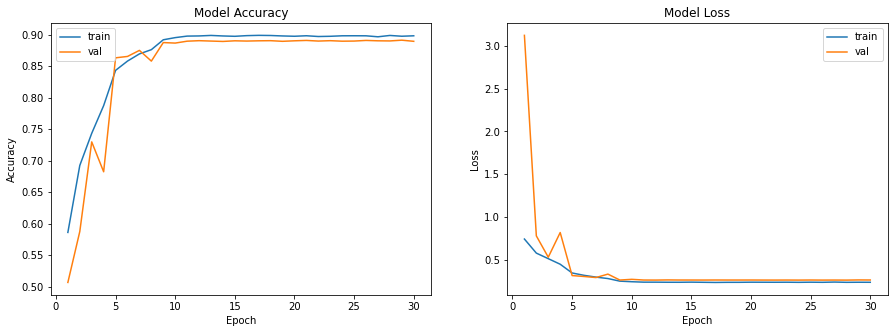

In [23]:
print('train loss:', history.history['loss'][-1])
print('train accuracy:', history.history['accuracy'][-1])

print('dev loss:', history.history['val_loss'][-1])
print('dev accuracy:', history.history['val_accuracy'][-1])

fig, axs = plt.subplots(1,2,figsize=(15,5))

axs[0].plot(range(1,len(history.history['accuracy'])+1), history.history['accuracy'])
axs[0].plot(range(1,len(history.history['val_accuracy'])+1),history.history['val_accuracy'])
axs[0].set_title('Model Accuracy')
axs[0].set_ylabel('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].legend(['train', 'val'], loc='best')

axs[1].plot(range(1,len(history.history['loss'])+1),history.history['loss'])
axs[1].plot(range(1,len(history.history['val_loss'])+1),history.history['val_loss'])
axs[1].set_title('Model Loss')
axs[1].set_ylabel('Loss')
axs[1].set_xlabel('Epoch')
axs[1].legend(['train', 'val'], loc='best')

plt.show()

In [24]:
predictions = model.predict(x_test)

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Ide

Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:

Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361830 in device /job:

In [25]:
print(predictions)

y_pred = []

for i in predictions:
    if i[0] < i[1]:
        y_pred.append(1)
    else:
        y_pred.append(0)

[[5.38654218e-04 9.99461353e-01 6.29470217e-13 ... 6.85789045e-13
  8.54882625e-13 6.65614374e-13]
 [9.73211508e-03 9.90266979e-01 8.10889134e-10 ... 8.59052884e-10
  9.57471324e-10 9.74341052e-10]
 [7.80799252e-04 9.99219179e-01 9.46984529e-15 ... 1.05438831e-14
  1.50159528e-14 1.10344363e-14]
 ...
 [1.43372148e-01 8.56627524e-01 3.45830059e-10 ... 3.63347352e-10
  4.11283035e-10 3.69123454e-10]
 [1.16896797e-02 9.88310218e-01 1.20529739e-10 ... 1.31186631e-10
  1.51252288e-10 1.30416219e-10]
 [5.83847250e-05 9.99941587e-01 6.34847621e-17 ... 7.07386662e-17
  1.07523845e-16 7.88851975e-17]]


In [26]:
pred = np.array(predictions)

print(pred.shape)

(5000, 1000)


In [27]:
from sklearn.metrics import confusion_matrix

confusion_mtx = confusion_matrix(y_test, y_pred)

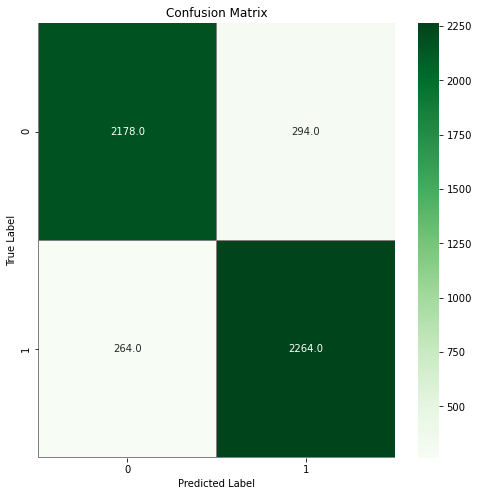

In [28]:
import seaborn as sns

f, ax = plt.subplots(figsize=(8, 8))
sns.heatmap(confusion_mtx, annot=True, linewidths=0.01, cmap="Greens",linecolor="gray", fmt='.1f', ax=ax)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

In [29]:
from sklearn.metrics import classification_report

# Generate a classification report
report = classification_report(y_test, y_pred, target_names=['cat', 'dog'])

In [30]:
print(report)

              precision    recall  f1-score   support

         cat       0.89      0.88      0.89      2472
         dog       0.89      0.90      0.89      2528

    accuracy                           0.89      5000
   macro avg       0.89      0.89      0.89      5000
weighted avg       0.89      0.89      0.89      5000

